# Home Credit Default Risk (HCDR)

The course project is based on the [Home Credit Default Risk (HCDR)  Kaggle Competition](https://www.kaggle.com/c/home-credit-default-risk/). The goal of this project is to predict whether or not a client will repay a loan. In order to make sure that people who struggle to get loans due to insufficient or non-existent credit histories have a positive loan experience, Home Credit makes use of a variety of alternative data--including telco and transactional information--to predict their clients' repayment abilities.


## Some of the challenges

1. Dataset size 
   * (688 meg uncompressed) with millions of rows of data
   * 2.71 Gig of data uncompressed
* Dealing with missing data
* Imbalanced datasets
* Summarizing transaction data


# Kaggle API setup
Kaggle is a Data Science Competition Platform which shares a lot of datasets. In the past, it was troublesome to submit your result as your have to go through the console in your browser and drag your files there. Now you can interact with Kaggle via the command line. E.g., 

```bash
! kaggle competitions files home-credit-default-risk
```

It is quite easy to setup, it takes me less than 15 minutes to finish a submission.

1. Install library
* Create a API Token (edit your profile on [Kaggle.com](https://www.kaggle.com/)); this produces `kaggle.json` file
* Put your JSON `kaggle.json` in the right place
* Access competition files; make submissions via the command (see examples below)
* Submit result

For more detailed information on setting the Kaggle API see [here](https://medium.com/@nokkk/make-your-kaggle-submissions-with-kaggle-official-api-f49093c04f8a) and [here](https://github.com/Kaggle/kaggle-api).



# Dataset and how to download


## Back ground Home Credit Group

Many people struggle to get loans due to insufficient or non-existent credit histories. And, unfortunately, this population is often taken advantage of by untrustworthy lenders.

### Home Credit Group

Home Credit strives to broaden financial inclusion for the unbanked population by providing a positive and safe borrowing experience. In order to make sure this underserved population has a positive loan experience, Home Credit makes use of a variety of alternative data--including telco and transactional information--to predict their clients' repayment abilities.

While Home Credit is currently using various statistical and machine learning methods to make these predictions, they're challenging Kagglers to help them unlock the full potential of their data. Doing so will ensure that clients capable of repayment are not rejected and that loans are given with a principal, maturity, and repayment calendar that will empower their clients to be successful.


## Background on the dataset
Home Credit is a non-banking financial institution, founded in 1997 in the Czech Republic.

The company operates in 14 countries (including United States, Russia, Kazahstan, Belarus, China, India) and focuses on lending primarily to people with little or no credit history which will either not obtain loans or became victims of untrustworthly lenders.

Home Credit group has over 29 million customers, total assests of 21 billions Euro, over 160 millions loans, with the majority in Asia and and almost half of them in China (as of 19-05-2018).

While Home Credit is currently using various statistical and machine learning methods to make these predictions, they're challenging Kagglers to help them unlock the full potential of their data. Doing so will ensure that clients capable of repayment are not rejected and that loans are given with a principal, maturity, and repayment calendar that will empower their clients to be successful.

## Data files overview
There are 7 different sources of data:

* __application_train/application_test:__ the main training and testing data with information about each loan application at Home Credit. Every loan has its own row and is identified by the feature SK_ID_CURR. The training application data comes with the TARGET indicating __0: the loan was repaid__ or __1: the loan was not repaid__. The target variable defines if the client had payment difficulties meaning he/she had late payment more than X days on at least one of the first Y installments of the loan. Such case is marked as 1 while other all other cases as 0.
* __bureau:__ data concerning client's previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.
* __bureau_balance:__ monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length.
* __previous_application:__ previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature SK_ID_PREV.
* __POS_CASH_BALANCE:__ monthly data about previous point of sale or cash loans clients have had with Home Credit. Each row is one month of a previous point of sale or cash loan, and a single previous loan can have many rows.
* credit_card_balance: monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.
* __installments_payment:__ payment history for previous loans at Home Credit. There is one row for every made payment and one row for every missed payment.

In [1]:
# ![alt](home_credit.png "Home credit")

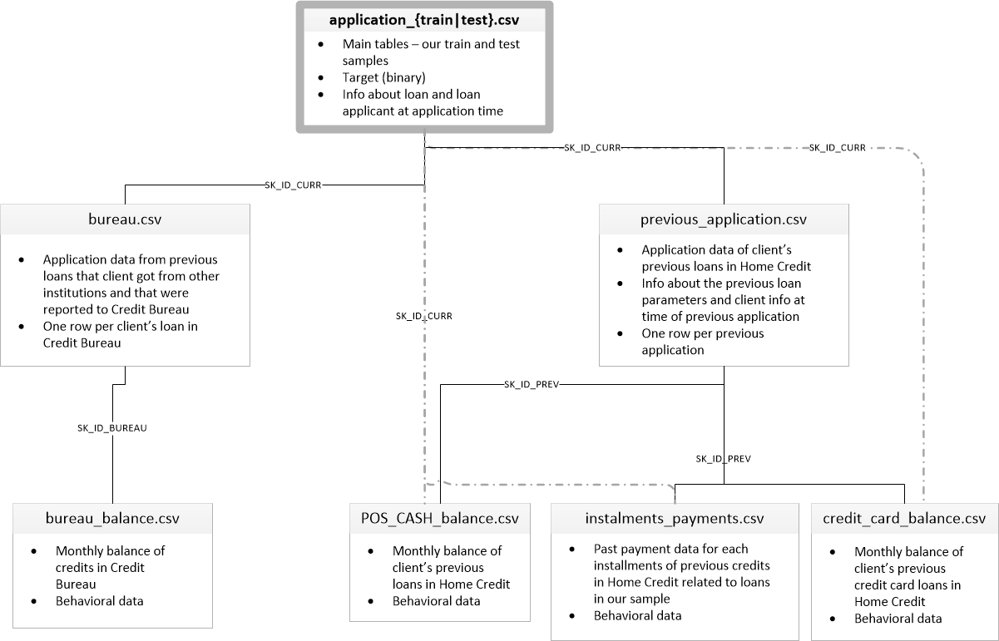

### Imports

In [2]:
import numpy as np
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import zipfile
from sklearn.base import BaseEstimator, TransformerMixin
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
import warnings
warnings.filterwarnings('ignore')
from datatile.summary.df import DataFrameSummary
pd.set_option('display.max_rows', 150)
pd.set_option('display.max_columns', 150)

In [3]:
unzippingReq = False
if unzippingReq: #please modify this code 
    zip_ref = zipfile.ZipFile('application_train.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('application_test.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('bureau_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('bureau.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('credit_card_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('installments_payments.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('POS_CASH_balance.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()
    zip_ref = zipfile.ZipFile('previous_application.csv.zip', 'r')
    zip_ref.extractall('datasets')
    zip_ref.close()

### Application train

In [4]:
import numpy as np
import pandas as pd 
from sklearn.preprocessing import LabelEncoder
import os
import zipfile
from sklearn.base import BaseEstimator, TransformerMixin
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
import warnings
warnings.filterwarnings('ignore')
from datatile.summary.df import DataFrameSummary

def load_data(in_path, name):
    df = pd.read_csv(in_path)
    print(f"{name}: shape is {df.shape}")
    print(df.info())
    display(df.head(5))
    return df

DATA_DIR2="./Data/"
datasets={}  # lets store the datasets in a dictionary so we can keep track of them easily
ds_name = 'application_train'
datasets[ds_name] = load_data(os.path.join(DATA_DIR2, f'{ds_name}.csv'), ds_name)

datasets['application_train'].shape

application_train: shape is (307511, 122)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

(307511, 122)

### Application test


* __application_train/application_test:__ the main training and testing data with information about each loan application at Home Credit. Every loan has its own row and is identified by the feature SK_ID_CURR. The training application data comes with the TARGET indicating __0: the loan was repaid__ or __1: the loan was not repaid__. The target variable defines if the client had payment difficulties meaning he/she had late payment more than X days on at least one of the first Y installments of the loan. Such case is marked as 1 while other all other cases as 0.


In [5]:
ds_name = 'application_test'
datasets[ds_name] = load_data(os.path.join(DATA_DIR2, f'{ds_name}.csv'), ds_name)

application_test: shape is (48744, 121)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB
None


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married

In [6]:
!pip install pandas-profiling

In [7]:
import warnings
warnings.simplefilter('ignore')

# !pip install pandas-profiling
cols = ['TARGET','NAME_CONTRACT_TYPE','CODE_GENDER','FLAG_OWN_CAR','FLAG_OWN_REALTY','CNT_CHILDREN','AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','NAME_EDUCATION_TYPE','DAYS_BIRTH','DAYS_EMPLOYED','OWN_CAR_AGE','FLAG_MOBIL','OCCUPATION_TYPE','CNT_FAM_MEMBERS','ORGANIZATION_TYPE','APARTMENTS_AVG','BASEMENTAREA_AVG','YEARS_BUILD_AVG','FLOORSMAX_AVG','LANDAREA_AVG','LIVINGAPARTMENTS_AVG','LIVINGAREA_AVG','NONLIVINGAPARTMENTS_AVG','NONLIVINGAREA_AVG']
len(cols)

from pandas_profiling import ProfileReport
profiling_report = ProfileReport(datasets['application_train'][cols],title='HomeCredit Dataset pandas profiling of non-housing related columns',explorative = True)


In [8]:
profiling_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The application dataset has the most information about the client: Gender, income, family status, education ...

### The Other datasets

* __bureau:__ data concerning client's previous credits from other financial institutions. Each previous credit has its own row in bureau, but one loan in the application data can have multiple previous credits.
* __bureau_balance:__ monthly data about the previous credits in bureau. Each row is one month of a previous credit, and a single previous credit can have multiple rows, one for each month of the credit length.
* __previous_application:__ previous applications for loans at Home Credit of clients who have loans in the application data. Each current loan in the application data can have multiple previous loans. Each previous application has one row and is identified by the feature SK_ID_PREV.
* __POS_CASH_BALANCE:__ monthly data about previous point of sale or cash loans clients have had with Home Credit. Each row is one month of a previous point of sale or cash loan, and a single previous loan can have many rows.
* credit_card_balance: monthly data about previous credit cards clients have had with Home Credit. Each row is one month of a credit card balance, and a single credit card can have many rows.
* __installments_payment:__ payment history for previous loans at Home Credit. There is one row for every made payment and one row for every missed payment.

In [9]:
%%time
ds_names = ("application_train", "application_test", "bureau","bureau_balance","credit_card_balance","installments_payments",
            "previous_application","POS_CASH_balance")

for ds_name in ds_names:
    datasets[ds_name] = load_data(os.path.join(DATA_DIR2, f'{ds_name}.csv'), ds_name)


application_train: shape is (307511, 122)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB
None


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

application_test: shape is (48744, 121)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB
None


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Married

bureau: shape is (1716428, 17)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB
None


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


bureau_balance: shape is (27299925, 3)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   SK_ID_BUREAU    int64 
 1   MONTHS_BALANCE  int64 
 2   STATUS          object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB
None


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


credit_card_balance: shape is (3840312, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   SK_ID_PREV                  int64  
 1   SK_ID_CURR                  int64  
 2   MONTHS_BALANCE              int64  
 3   AMT_BALANCE                 float64
 4   AMT_CREDIT_LIMIT_ACTUAL     int64  
 5   AMT_DRAWINGS_ATM_CURRENT    float64
 6   AMT_DRAWINGS_CURRENT        float64
 7   AMT_DRAWINGS_OTHER_CURRENT  float64
 8   AMT_DRAWINGS_POS_CURRENT    float64
 9   AMT_INST_MIN_REGULARITY     float64
 10  AMT_PAYMENT_CURRENT         float64
 11  AMT_PAYMENT_TOTAL_CURRENT   float64
 12  AMT_RECEIVABLE_PRINCIPAL    float64
 13  AMT_RECIVABLE               float64
 14  AMT_TOTAL_RECEIVABLE        float64
 15  CNT_DRAWINGS_ATM_CURRENT    float64
 16  CNT_DRAWINGS_CURRENT        int64  
 17  CNT_DRAWINGS_OTHER_CURRENT  float64
 18  CNT_DRAWINGS_POS_C

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


installments_payments: shape is (13605401, 8)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_PREV              int64  
 1   SK_ID_CURR              int64  
 2   NUM_INSTALMENT_VERSION  float64
 3   NUM_INSTALMENT_NUMBER   int64  
 4   DAYS_INSTALMENT         float64
 5   DAYS_ENTRY_PAYMENT      float64
 6   AMT_INSTALMENT          float64
 7   AMT_PAYMENT             float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB
None


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


previous_application: shape is (1670214, 37)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 1

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


POS_CASH_balance: shape is (10001358, 8)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   NAME_CONTRACT_STATUS   object 
 6   SK_DPD                 int64  
 7   SK_DPD_DEF             int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB
None


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


CPU times: user 25.7 s, sys: 4.09 s, total: 29.8 s
Wall time: 31.9 s


In [10]:
for ds_name in datasets.keys():
    print(f'dataset {ds_name:24}: [ {datasets[ds_name].shape[0]:10,}, {datasets[ds_name].shape[1]}]')

    

dataset application_train       : [    307,511, 122]
dataset application_test        : [     48,744, 121]
dataset bureau                  : [  1,716,428, 17]
dataset bureau_balance          : [ 27,299,925, 3]
dataset credit_card_balance     : [  3,840,312, 23]
dataset installments_payments   : [ 13,605,401, 8]
dataset previous_application    : [  1,670,214, 37]
dataset POS_CASH_balance        : [ 10,001,358, 8]


# Exploratory Data Analysis

## Summary of Application train

In [17]:
datasets.keys()

dict_keys(['application_train', 'application_test', 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 'previous_application', 'POS_CASH_balance'])

In [18]:
datasets["application_train"].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [19]:
datasets["application_train"].describe() #numerical only features

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307509.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,159080.000000,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.056720,2.152665,2.052463,2.031521,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,0.502130,5.143927e-01,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.074490,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.117850,0.087955,0.97

In [20]:
datasets["application_test"].describe() #numerical only features

,SK_ID_CURR,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.000000,48744.000000,4.874400e+04,4.874400e+04,48720.000000,4.874400e+04,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,16432.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,28212.000000,48736.000000,40076.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,24857.000000,21103.000000,25888.000000,16926.000000,15249.000000,23555.000000,25165.000000,25423.000000,16278.000000,20490.000000,15964.000000,25192.000000,15397.000000,22660.000000,26120.000000,48715.000000,48715.000000,48715.000000,48715.000000,48744.000000,48744.0,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.000000,48744.0,48744.000000,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.000000,48744.0,48744.0,48744.0,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000,42695.000000
mean,277796.676350,0.397054,1.784318e+05,5.167404e+05,29426.240209,4.626188e+05,0.021226,-16068.084605,67485.366322,-4967.652716,-3051.712949,11.786027,0.999979,0.809720,0.204702,0.998400,0.263130,0.162646,2.146767,2.038159,2.012596,12.007365,0.018833,0.055166,0.042036,0.077466,0.224664,0.174216,0.501180,0.518021,0.500106,0.122388,0.090065,0.978828,0.751137,0.047624,0.085168,0.151777,0.233706,0.238423,0.067192,0.105885,0.112286,0.009231,0.029387,0.119078,0.088998,0.978292,0.758327,0.045223,0.080570,0.147161,0.229390,0.233854,0.065914,0.110874,0.110687,0.008358,0.028161,0.122809,0.089529,0.978822,0.754344,0.047420,0.084128,0.151200,0.233154,0.237846,0.068069,0.107063,0.113368,0.008979,0.029296,0.107129,1.447644,0.143652,1.435738,0.101139,-1077.766228,0.0,0.786620,

In [21]:
datasets["application_train"].describe(include='all') #look at all categorical and numerical

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511,307511,307511,307511,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,306219,307511,307511,307511,307511,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,104582.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,211120,307509.000000,307511.000000,307511.000000,307511,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511,134133.000000,3.068510e+05,246546.000000,151450.00000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,151450.000000,127568.000000,157504.000000,103023.000000,92646.000000,143620.000000,152683.000000,154491.000000,98869.000000,124921.000000,97312.000000,153161.000000,93997.000000,137829.000000,97216,153214,159080.000000,151170,161756,306490.000000,306490.000000,306490.000000,306490.000000,307510.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.00000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
unique,NaN,NaN,2,3,2,2,NaN,NaN,NaN,NaN,NaN,7,8,5,6,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,NaN,NaN,NaN,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

## Missing data for application train

In [22]:
percent = (datasets["application_train"].isnull().sum()/datasets["application_train"].isnull().count()*100).sort_values(ascending = False).round(2)
sum_missing = datasets["application_train"].isna().sum().sort_values(ascending = False)
missing_application_train_data  = pd.concat([percent, sum_missing], axis=1, keys=['Percent', "Train Missing Count"])
missing_application_train_data.head(20)

,Percent,Train Missing Count
COMMONAREA_MEDI,69.87,214865
COMMONAREA_AVG,69.87,214865
COMMONAREA_MODE,69.87,214865
NONLIVINGAPARTMENTS_MODE,69.43,213514
NONLIVINGAPARTMENTS_AVG,69.43,213514
NONLIVINGAPARTMENTS_MEDI,69.43,213514
FONDKAPREMONT_MODE,68.39,210295
LIVINGAPARTMENTS_MODE,68.35,210199
LIVINGAPARTMENTS_AVG,68.35,210199
LIVINGAPARTMENTS_MEDI,68.35,210199


In [23]:
percent = (datasets["application_test"].isnull().sum()/datasets["application_test"].isnull().count()*100).sort_values(ascending = False).round(2)
sum_missing = datasets["application_test"].isna().sum().sort_values(ascending = False)
missing_application_train_data  = pd.concat([percent, sum_missing], axis=1, keys=['Percent', "Test Missing Count"])
missing_application_train_data.head(20)

,Percent,Test Missing Count
COMMONAREA_AVG,68.72,33495
COMMONAREA_MODE,68.72,33495
COMMONAREA_MEDI,68.72,33495
NONLIVINGAPARTMENTS_AVG,68.41,33347
NONLIVINGAPARTMENTS_MODE,68.41,33347
NONLIVINGAPARTMENTS_MEDI,68.41,33347
FONDKAPREMONT_MODE,67.28,32797
LIVINGAPARTMENTS_AVG,67.25,32780
LIVINGAPARTMENTS_MODE,67.25,32780
LIVINGAPARTMENTS_MEDI,67.25,32780


## Distribution of the target column 

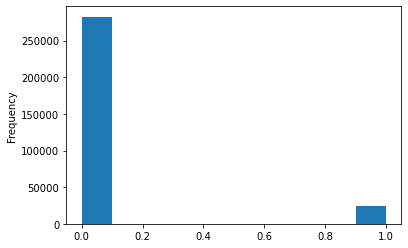

In [24]:
datasets["application_train"]['TARGET'].astype(int).plot.hist();

## Correlation with  the target column 

In [25]:
correlations = datasets["application_train"].corr()['TARGET'].sort_values()
print('Most Positive Correlations:\n', correlations.tail(10))
print('\nMost Negative Correlations:\n', correlations.head(10))

Most Positive Correlations:
 FLAG_DOCUMENT_3                0.044346
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_WORK_CITY         0.050994
DAYS_ID_PUBLISH                0.051457
DAYS_LAST_PHONE_CHANGE         0.055218
REGION_RATING_CLIENT           0.058899
REGION_RATING_CLIENT_W_CITY    0.060893
DAYS_BIRTH                     0.078239
TARGET                         1.000000
Name: TARGET, dtype: float64

Most Negative Correlations:
 EXT_SOURCE_3                 -0.178919
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_1                 -0.155317
DAYS_EMPLOYED                -0.044932
FLOORSMAX_AVG                -0.044003
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_MODE               -0.043226
AMT_GOODS_PRICE              -0.039645
REGION_POPULATION_RELATIVE   -0.037227
ELEVATORS_AVG                -0.034199
Name: TARGET, dtype: float64


In [27]:
Summary_df = DataFrameSummary(datasets['application_train'])
Summary_df.summary()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.0,307511.0,NaN,NaN,NaN,NaN,307511.0,307511.0,307511.0,307499.0,307233.0,NaN,NaN,NaN,NaN,NaN,307511.0,307511.0,307511.0,307511.0,307511.0,104582.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,NaN,307509.0,307511.0,307511.0,NaN,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,NaN,134133.0,306851.0,246546.0,151450.0,127568.0,157504.0,103023.0,92646.0,143620.0,152683.0,154491.0,98869.0,124921.0,97312.0,153161.0,93997.0,137829.0,151450.0,127568.0,157504.0,103023.0,92646.0,143620.0,152683.0,154491.0,98869.0,124921.0,97312.0,153161.0,93997.0,137829.0,151450.0,127568.0,157504.0,103023.0,92646.0,143620.0,152683.0,154491.0,98869.0,124921.0,97312.0,153161.0,93997.0,137829.0,NaN,NaN,159080.0,NaN,NaN,306490.0,306490.0,306490.0,306490.0,307510.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,307511.0,265992.0,265992.0,265992.0,265992.0,265992.0,265992.0
mean,278180.518577,0.080729,NaN,NaN,NaN,NaN,0.417052,168797.919297,599025.999706,27108.573909,538396.207429,NaN,NaN,NaN,NaN,NaN,0.020868,-16036.995067,63815.045904,-4986.120328,-2994.202373,12.061091,0.999997,0.819889,0.199368,0.998133,0.281066,0.05672,NaN,2.152665,2.052463,2.031521,NaN,12.063419,0.015144,0.050769,0.040659,0.078173,0.230454,0.179555,NaN,0.50213,0.514393,0.510853,0.11744,0.088442,0.977735,0.752471,0.044621,0.078942,0.149725,0.226282,0.231894,0.066333,0.100775,0.107399,0.008809,0.028358,0.114231,0.087543,0.977065,0.759637,0.042553,0.07449,0.145193,0.222315,0.228058,0.064958,0.105645,0.105975,0.008076,0.027022,0.11785,0.087955,0.977752,0.755746,0.044595,0.078078,0.149213,0.225897,0.231625,0.067169,0.101954,0.108607,0.008651,0.028236,NaN,NaN,0.102547,NaN,NaN,1.42

In [28]:
Summary_df = DataFrameSummary(datasets['application_test'])
Summary_df.summary()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,48744.0,NaN,NaN,NaN,NaN,48744.0,48744.0,48744.0,48720.0,48744.0,NaN,NaN,NaN,NaN,NaN,48744.0,48744.0,48744.0,48744.0,48744.0,16432.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,NaN,48744.0,48744.0,48744.0,NaN,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,NaN,28212.0,48736.0,40076.0,24857.0,21103.0,25888.0,16926.0,15249.0,23555.0,25165.0,25423.0,16278.0,20490.0,15964.0,25192.0,15397.0,22660.0,24857.0,21103.0,25888.0,16926.0,15249.0,23555.0,25165.0,25423.0,16278.0,20490.0,15964.0,25192.0,15397.0,22660.0,24857.0,21103.0,25888.0,16926.0,15249.0,23555.0,25165.0,25423.0,16278.0,20490.0,15964.0,25192.0,15397.0,22660.0,NaN,NaN,26120.0,NaN,NaN,48715.0,48715.0,48715.0,48715.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,48744.0,42695.0,42695.0,42695.0,42695.0,42695.0,42695.0
mean,277796.67635,NaN,NaN,NaN,NaN,0.397054,178431.805855,516740.435561,29426.240209,462618.840473,NaN,NaN,NaN,NaN,NaN,0.021226,-16068.084605,67485.366322,-4967.652716,-3051.712949,11.786027,0.999979,0.80972,0.204702,0.9984,0.26313,0.162646,NaN,2.146767,2.038159,2.012596,NaN,12.007365,0.018833,0.055166,0.042036,0.077466,0.224664,0.174216,NaN,0.50118,0.518021,0.500106,0.122388,0.090065,0.978828,0.751137,0.047624,0.085168,0.151777,0.233706,0.238423,0.067192,0.105885,0.112286,0.009231,0.029387,0.119078,0.088998,0.978292,0.758327,0.045223,0.08057,0.147161,0.22939,0.233854,0.065914,0.110874,0.110687,0.008358,0.028161,0.122809,0.089529,0.978822,0.754344,0.04742,0.084128,0.1512,0.233154,0.237846,0.068069,0.107063,0.113368,0.008979,0.029296,NaN,NaN,0.107129,NaN,NaN,1.447644,0.143652,1.435738,0.101139,-1077.766228,0.0,0.78662,0.000103,0.014751,0.087477,0.000041,0.088462,0.004493,0.0,0.001169,

In [29]:
Summary_df = DataFrameSummary(datasets['bureau'])
Summary_df.summary()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
count,1716428.0,1716428.0,NaN,NaN,1716428.0,1716428.0,1610875.0,1082775.0,591940.0,1716428.0,1716415.0,1458759.0,1124648.0,1716428.0,NaN,1716428.0,489637.0
mean,278214.933645,5924434.489032,NaN,NaN,-1142.107685,0.818167,510.517362,-1017.437148,3825.417661,0.00641,354994.591918,137085.119952,6229.51498,37.912758,NaN,-593.74832,15712.7577
std,102938.558112,532265.728552,NaN,NaN,795.164928,36.544428,4994.219837,714.010626,206031.606207,0.096224,1149811.34398,677401.130952,45032.031476,5937.650035,NaN,720.747312,325826.949053
min,100001.0,5000000.0,NaN,NaN,-2922.0,0.0,-42060.0,-42023.0,0.0,0.0,0.0,-4705600.32,-586406.115,0.0,NaN,-41947.0,0.0
25%,188866.75,5463953.75,NaN,NaN,-1666.0,0.0,-1138.0,-1489.0,0.0,0.0,51300.0,0.0,0.0,0.0,NaN,-908.0,0.0
50%,278055.0,5926303.5,NaN,NaN,-987.0,0.0,-330.0,-897.0,0.0,0.0,125518.5,0.0,0.0,0.0,NaN,-395.0,0.0
75%,367426.0,6385681.25,NaN,NaN,-474.0,0.0,474.0,-425.0,0.0,0.0,315000.0,40153.5,0.0,0.0,NaN,-33.0,13500.0
max,456255.0,6843457.0,NaN,NaN,0.0,2792.0,31199.0,0.0,115987185.0,9.0,585000000.0,170100000.0,4705600.32,3756681.0,NaN,372.0,118453423.5
counts,1716428,1716428,1716428,1716428,1716428,1716428,1610875,1082775,591940,1716428,1716415,1458759,1124648,1716428,1716428,1716428,489637
uniques,305811,1716428,4,4,2923,942,14096,2917,68251,10,236708,226537,51726,1616,15,2982,40321


In [30]:
Summary_df = DataFrameSummary(datasets['bureau_balance'])
Summary_df.summary()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
count,27299925.0,27299925.0,NaN
mean,6036297.332974,-30.741687,NaN
std,492348.856904,23.864509,NaN
min,5001709.0,-96.0,NaN
25%,5730933.0,-46.0,NaN
50%,6070821.0,-25.0,NaN
75%,6431951.0,-11.0,NaN
max,6842888.0,0.0,NaN
counts,27299925,27299925,27299925
uniques,817395,97,8


In [31]:
Summary_df = DataFrameSummary(datasets['credit_card_balance'])
Summary_df.summary()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
count,3840312.0,3840312.0,3840312.0,3840312.0,3840312.0,3090496.0,3840312.0,3090496.0,3090496.0,3535076.0,3072324.0,3840312.0,3840312.0,3840312.0,3840312.0,3090496.0,3840312.0,3090496.0,3090496.0,3535076.0,NaN,3840312.0,3840312.0
mean,1904503.5899,278324.207289,-34.521921,58300.155262,153807.9574,5961.324822,7433.388179,288.169582,2968.804848,3540.204129,10280.537702,7588.856739,55965.876905,58088.811177,58098.285489,0.309449,0.703144,0.004812,0.559479,20.825084,NaN,9.283667,0.331622
std,536469.470563,102704.475133,26.667751,106307.031025,165145.699523,28225.688579,33846.077334,8201.989345,20796.887047,5600.154122,36078.084953,32005.987768,102533.616843,105965.369908,105971.801103,1.100401,3.190347,0.082639,3.240649,20.051494,NaN,97.5157,21.479231
min,1000018.0,100006.0,-96.0,-420250.185,0.0,-6827.31,-6211.62,0.0,0.0,0.0,0.0,0.0,-423305.82,-420250.185,-420250.185,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0
25%,1434385.0,189517.0,-55.0,0.0,45000.0,0.0,0.0,0.0,0.0,0.0,152.37,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,NaN,0.0,0.0
50%,1897122.0,278396.0,-28.0,0.0,112500.0,0.0,0.0,0.0,0.0,0.0,2702.7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15.0,NaN,0.0,0.0
75%,2369327.75,367580.0,-11.0,89046.68625,180000.0,0.0,0.0,0.0,0.0,6633.91125,9000.0,6750.0,85359.24,88899.49125,88914.51,0.0,0.0,0.0,0.0,32.0,NaN,0.0,0.0
max,2843496.0,456250.0,-1.0,1505902.185,1350000.0,2115000.0,2287098.315,1529847.0,2239274.16,202882.005,4289207.445,4278315.69,1472316.795,1493338.185,1493338.185,51.0,165.0,12.0,165.0,120.0,NaN,3260.0,3260.0
counts,3840312,3840312,3840312,3840312,3840312,3090496,3840312,3090496,3090496,3535076,3072324,3840312,3840312,3840312,3840312,3090496,3840312,3090496,3090496,3535076,3840312,3840312,3840312
uniques,104307,103558,96,1347904,181,2267,187005,1832,168748,312266,163209,182957,1195839,1338878,1339008,44,129,11,133,121,7,917,378


In [32]:
Summary_df = DataFrameSummary(datasets['installments_payments'])
Summary_df.summary()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
count,13605401.0,13605401.0,13605401.0,13605401.0,13605401.0,13602496.0,13605401.0,13602496.0
mean,1903364.969549,278444.881738,0.856637,18.870896,-1042.269992,-1051.113684,17050.906989,17238.22325
std,536202.905546,102718.310411,1.035216,26.664067,800.946284,800.585883,50570.254429,54735.783981
min,1000001.0,100001.0,0.0,1.0,-2922.0,-4921.0,0.0,0.0
25%,1434191.0,189639.0,0.0,4.0,-1654.0,-1662.0,4226.085,3398.265
50%,1896520.0,278685.0,1.0,8.0,-818.0,-827.0,8884.08,8125.515
75%,2369094.0,367530.0,1.0,19.0,-361.0,-370.0,16710.21,16108.425
max,2843499.0,456255.0,178.0,277.0,-1.0,-1.0,3771487.845,3771487.845
counts,13605401,13605401,13605401,13605401,13605401,13602496,13605401,13602496
uniques,997752,339587,65,277,2922,3039,902539,944235


In [34]:
Summary_df = DataFrameSummary(datasets['previous_application'])
Summary_df.summary()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1670214.0,1670214.0,NaN,1297979.0,1670214.0,1670213.0,774370.0,1284699.0,NaN,1670214.0,NaN,1670214.0,774370.0,5951.0,5951.0,NaN,NaN,1670214.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1670214.0,NaN,1297984.0,NaN,NaN,997149.0,997149.0,997149.0,997149.0,997149.0,997149.0
mean,1923089.135331,278357.174099,NaN,15955.120659,175233.86036,196114.021218,6697.402139,227847.279283,NaN,12.484182,NaN,0.996468,0.079637,0.188357,0.773503,NaN,NaN,-880.679668,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,313.951115,NaN,16.054082,NaN,NaN,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.33257
std,532597.958696,102814.823849,NaN,14782.137335,292779.762387,318574.616546,20921.49541,315396.557937,NaN,3.334028,NaN,0.05933,0.107823,0.087671,0.100879,NaN,NaN,779.099667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7127.443459,NaN,14.567288,NaN,NaN,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1000001.0,100001.0,NaN,0.0,0.0,0.0,-0.9,0.0,NaN,0.0,NaN,0.0,-0.000015,0.034781,0.37315,NaN,NaN,-2922.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,0.0,NaN,NaN,-2922.0,-2892.0,-2801.0,-2889.0,-2874.0,0.0
25%,1461857.25,189329.0,NaN,6321.78,18720.0,24160.5,0.0,50841.0,NaN,10.0,NaN,1.0,0.0,0.160716,0.715645,NaN,NaN,-1300.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.0,NaN,6.0,NaN,NaN,365243.0,-1628.0,-1242.0,-1314.0,-1270.0,0.0
50%,1923110.5,278714.5,NaN,11250.0,71046.0,80541.0,1638.0,112320.0,NaN,12.0,NaN,1.0,0.051605,0.189122,0.835095,NaN,NaN,-581.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,12.0,NaN,NaN,365243.0,-831.0,-361.0,-537.0,-499.0,0.0
75%,2384279.75,367514.0,NaN,20658.42,180360.0,216418.5,7740.0,234000.0,NaN,15.0,NaN,1.0,0.108909,0.19333,0.852537,NaN,NaN,-280.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.0,NaN,24.0,NaN,NaN,365243.0,-411.0,129.0,-74.0,-44.0,1.0
max,2845382.0,456255.0,NaN,418058.145,6905160.0,6905160.0,3060045.0,6905160.0,NaN,23.0,NaN,1.0,1.0,1.0,1.0,NaN,NaN,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4000000.0,NaN,84.0,NaN,NaN,365243.0,365243.0,365243.0,365243.0,365243.0,1.0
counts,1670214,1670214,1670214,1297979,1670214,1670213,774370,1284699,1670214,1670214,1670214,1670214,774370,5951,5951,1670214,1670214,1670214,1670214,1670214,849809,1670214,1670214,1670214,1670214,1670214,1670214,1670214,1297984,1670214,1669868,997149,997149,997149,997149,997149,997149
uniques,1670214,338857,4,357959,93885,86803,29278,93885,7,24,2,2,207033,148,25,25,4,2922,4,9,7,4,28,5,3,8,2097,11,49,5,17,2838,2892,4605,2873,2830,2


In [35]:
Summary_df = DataFrameSummary(datasets['POS_CASH_balance'])
Summary_df.summary()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
count,10001358.0,10001358.0,10001358.0,9975287.0,9975271.0,NaN,10001358.0,10001358.0
mean,1903216.598957,278403.863306,-35.012588,17.08965,10.48384,NaN,11.606928,0.654468
std,535846.530722,102763.74509,26.06657,11.995056,11.109058,NaN,132.714043,32.762491
min,1000001.0,100001.0,-96.0,1.0,0.0,NaN,0.0,0.0
25%,1434405.0,189550.0,-54.0,10.0,3.0,NaN,0.0,0.0
50%,1896565.0,278654.0,-28.0,12.0,7.0,NaN,0.0,0.0
75%,2368963.0,367429.0,-13.0,24.0,14.0,NaN,0.0,0.0
max,2843499.0,456255.0,-1.0,92.0,85.0,NaN,4231.0,3595.0
counts,10001358,10001358,10001358,9975287,9975271,10001358,10001358,10001358
uniques,936325,337252,96,73,79,9,3400,2307


In [36]:
import warnings
warnings.simplefilter('ignore')
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
%pylab inline

from sklearn.model_selection import train_test_split  # sklearn.cross_validation in old versions
import re
from time import time
from scipy import stats
import json

import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 150)
pd.set_option('display.max_columns', 150)

Populating the interactive namespace from numpy and matplotlib


In [37]:
# Ref : https://stackoverflow.com/questions/45985877/slicing-multiple-column-ranges-from-a-dataframe-using-iloc

# Create a custom function for indexing
def all_nums_in_range(*tuple_pairs, len_df):
    """
    Input pairs of tuples for index slicing

    Include `len_df` to ensure length of array matches indexed df
    """

    # Create an array with values to use as an index
    num_range = np.zeros(shape=(len_df,), dtype=bool)

    # Update
    for (start, end) in tuple_pairs:
        num_range[start:end] = True

    return num_range

### A breakdown of the defaulters with respect to genders

In [51]:
df_gender = application_train[['CODE_GENDER','TARGET']]
df_gender['count'] = 1
df_gender = df_gender.groupby(['CODE_GENDER','TARGET']).sum()
df_gender = pd.DataFrame(df_gender.reset_index())
display(df_gender)

,CODE_GENDER,TARGET,count
0,F,0,188278
1,F,1,14170
2,M,0,94404
3,M,1,10655
4,XNA,0,4


In [52]:
list(df_gender[df_gender['CODE_GENDER']=='F']['count'].values)

[188278, 14170]

In [53]:
df_gender.head()

,CODE_GENDER,TARGET,count
0,F,0,188278
1,F,1,14170
2,M,0,94404
3,M,1,10655
4,XNA,0,4


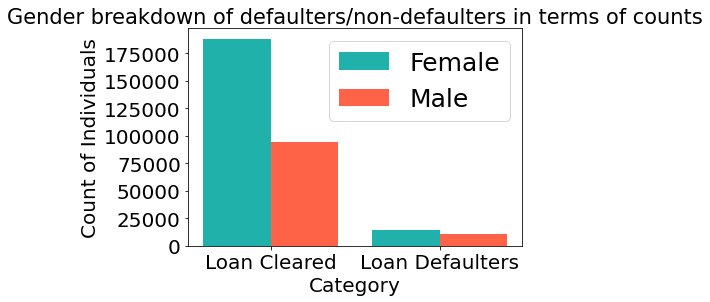

In [54]:
x = ['Loan Cleared','Loan Defaulters']
yF = [int(df_gender[(df_gender['CODE_GENDER']=='F') & (df_gender['TARGET']==0)]['count'].values),int(df_gender[(df_gender['CODE_GENDER']=='F') & (df_gender['TARGET']==1)]['count'].values)]
yM = [int(df_gender[(df_gender['CODE_GENDER']=='M') & (df_gender['TARGET']==0)]['count'].values),int(df_gender[(df_gender['CODE_GENDER']=='M') & (df_gender['TARGET']==1)]['count'].values)]
  


X_axis = np.arange(len(x))
  
plt.bar(X_axis - 0.2, yF, 0.4, label = 'Female',color =['lightseagreen'],)
plt.bar(X_axis + 0.2, yM, 0.4, label = 'Male',color =['tomato'])
  
plt.xticks(X_axis, x,fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel("Category",fontsize=20)
plt.ylabel("Count of Individuals",fontsize=20)
plt.title("Gender breakdown of defaulters/non-defaulters in terms of counts",fontsize=21)

plt.legend(fontsize=25)
plt.show()

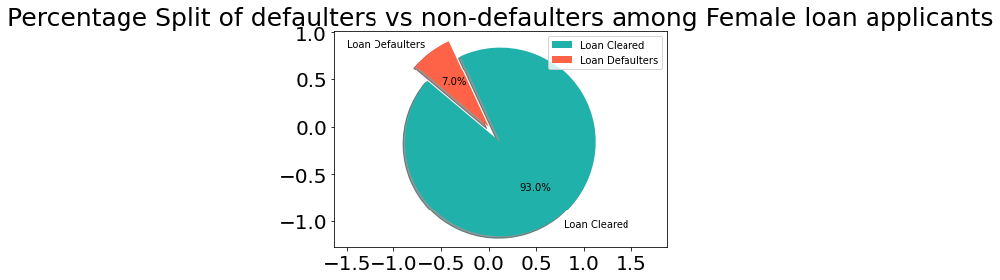

In [55]:
# Data to plot
labels = ['Loan Cleared','Loan Defaulters']
sizes = [df_gender[df_gender['CODE_GENDER']=='F']['TARGET']]
colors = ['lightseagreen', 'tomato']
explode = (0.2, 0)  # explode 1st slice

# Plot
plt.pie(list(df_gender[df_gender['CODE_GENDER']=='F']['count'].values), explode=explode,radius=1, frame=True,labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.axis('equal')
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
plt.legend(fontsize=10)
plt.title('Percentage Split of defaulters vs non-defaulters among Female loan applicants',fontsize=25
         )
plt.show()

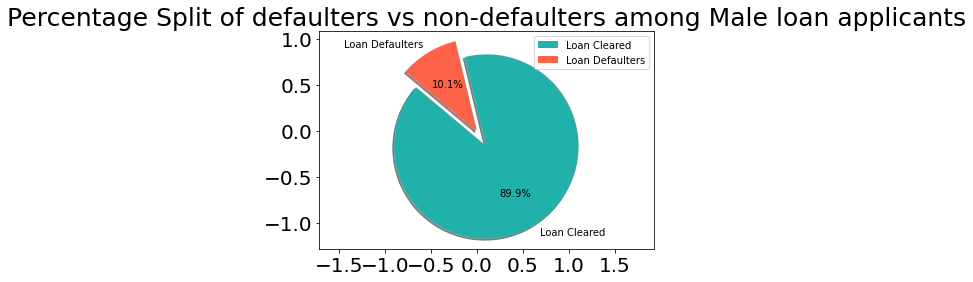

In [56]:
# Data to plot
labels = ['Loan Cleared','Loan Defaulters']
sizes = [df_gender[df_gender['CODE_GENDER']=='M']['TARGET']]
color =['lightseagreen', 'tomato']
explode = (0.2, 0)  # explode 1st slice

# Plot
plt.pie(list(df_gender[df_gender['CODE_GENDER']=='M']['count'].values), explode=explode, frame=True,labels=labels, colors=colors,
autopct='%1.1f%%', shadow=True, startangle=140)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
plt.axis('equal')
plt.legend(fontsize=10)
plt.title('Percentage Split of defaulters vs non-defaulters among Male loan applicants',fontsize=25)
plt.show()

### 0.2.3. Based on the above visualizations we see that there are a much larger number of Women who have cleared their loans and in terms of of percentage split across the genders women are more likely to clear their loans than men

### 0.2.4. Let us now add their income to the mix and understand how that impacts individual's ability to payback their loans

In [57]:
df_gender_income = application_train[['CODE_GENDER','AMT_INCOME_TOTAL','TARGET']]

In [58]:
df_gender_income.head()
df_gender_income = df_gender_income[df_gender_income['CODE_GENDER']!='XNA']
# df_gender_income.loc[df_gender_income['TARGET']==0] = 'Cleared'
# df_gender_income.loc[df_gender_income['TARGET']==1] = 'Defaulted'

[Text(0, 0, 'Cleared'), Text(1, 0, 'Defaulted')]

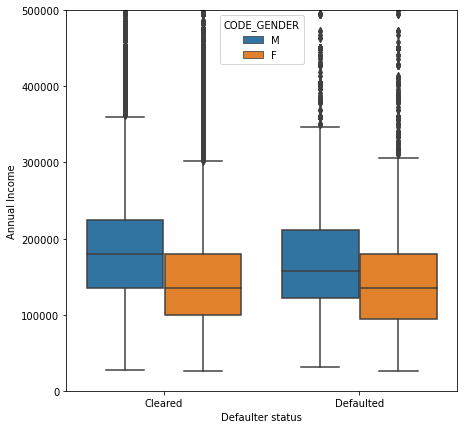

In [59]:
# https://stackoverflow.com/questions/16592222/matplotlib-group-boxplots
import seaborn as sns
fig,ax = plt.subplots(figsize = (7,7))
g = sns.boxplot(x='TARGET',y='AMT_INCOME_TOTAL',hue='CODE_GENDER',data=df_gender_income)
plt.xlabel('Defaulter status')
plt.ylabel('Annual Income')
plt.ylim(0, 500000)
g.set_xticklabels(['Cleared','Defaulted'])

### 0.2.5. An interesting observation here is that despite the fact that women earn lower on an average - even significantly lesser than men who have defaulted - they still manage to clear loans.

### 0.2.6. Looking at the boxplot, it almost seems as though income is not a major factor that affects Women's ability to clear a loan ( when it should be the case logically speaking, as we can see in the case of men where men with a lower income are more likely to default on their loan 

### 0.2.7. Next we will try understanding how a person's financial status correlate with factors such as the family size, number of children, size of house, their loan size, age .etc.

In [60]:
corr_cols = ['CNT_CHILDREN','AMT_CREDIT','DAYS_BIRTH','DAYS_EMPLOYED','CNT_FAM_MEMBERS','CNT_CHILDREN','YEARS_BUILD_MODE','TOTALAREA_MODE','TARGET']
df_corr = application_train[corr_cols]

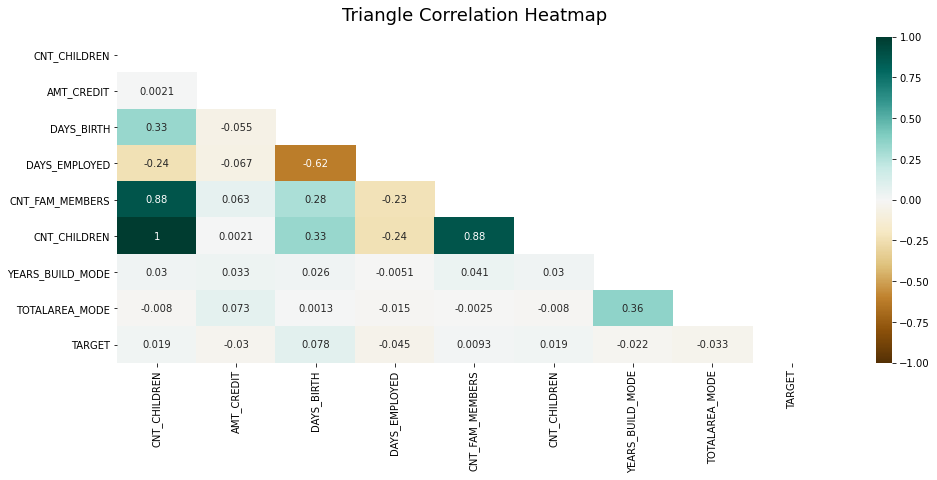

In [61]:
# Ref : https://medium.com/@szabo.bibor/how-to-create-a-seaborn-correlation-heatmap-in-python-834c0686b88e
plt.figure(figsize=(16, 6))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df_corr.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_corr.corr(), mask=mask, vmin=-1, vmax=1, annot=True,cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

### 0.2.8. There seem to be no meaningful insights from the above correlation plot

### 0.2.9. Does owning a car make a difference ?

In [62]:
df_car = application_train[['FLAG_OWN_CAR','TARGET']]

df_car = df_car.value_counts().reset_index(name='Count')

df_car

,FLAG_OWN_CAR,TARGET,Count
0,N,0,185675
1,Y,0,97011
2,N,1,17249
3,Y,1,7576


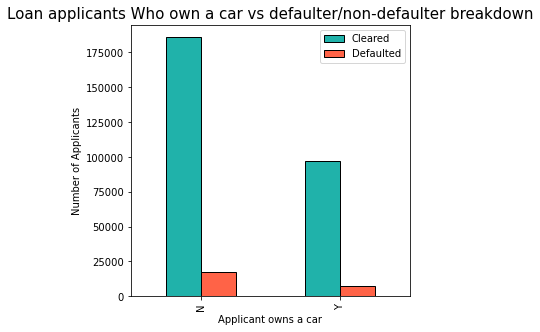

In [63]:
pivot = pd.pivot(data=df_car,index=['FLAG_OWN_CAR'],columns=['TARGET'],values='Count')
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(color =['lightseagreen', 'tomato'], figsize=(5,5),width=0.5,edgecolor='black')
ax.set_title('Loan applicants Who own a car vs defaulter/non-defaulter breakdown', fontsize=15)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Applicant owns a car', ylabel='Number of Applicants')
ax.legend(['Cleared','Defaulted'])

# ax.show()

### 0.2.10. One clear thing we can observe here is that applicants without a vehicle tend to apply for loans more than those who own one, but in terms of the defaulters it does not seem to make a difference and the ratio of defaulters to non defaulters is very similar in both cases.

In [64]:
df_car = application_train[['FLAG_OWN_CAR','TARGET']]

df_car = df_car.groupby('FLAG_OWN_CAR')['TARGET'].value_counts(normalize=True).reset_index(name='Count')

df_car

,FLAG_OWN_CAR,TARGET,Count
0,N,0,0.914998
1,N,1,0.085002
2,Y,0,0.927563
3,Y,1,0.072437


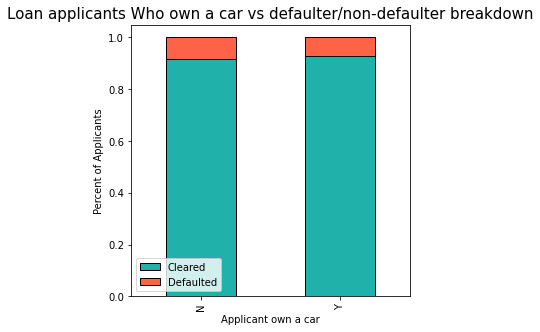

In [65]:
pivot = pd.pivot(data=df_car,index=['FLAG_OWN_CAR'],columns=['TARGET'],values='Count')
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(color =['lightseagreen', 'tomato'], figsize=(5,5),width=0.5,edgecolor='black',stacked=True)
ax.set_title('Loan applicants Who own a car vs defaulter/non-defaulter breakdown', fontsize=15)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Applicant own a car', ylabel='Percent of Applicants')
ax.legend(['Cleared','Defaulted'])
# ax.show()

### 0.2.11. Does owning a house make a difference ?

In [66]:
df_house = application_train[['FLAG_OWN_REALTY','TARGET']]

df_house = df_house.value_counts().reset_index(name='Count')

df_house

,FLAG_OWN_REALTY,TARGET,Count
0,Y,0,196329
1,N,0,86357
2,Y,1,16983
3,N,1,7842


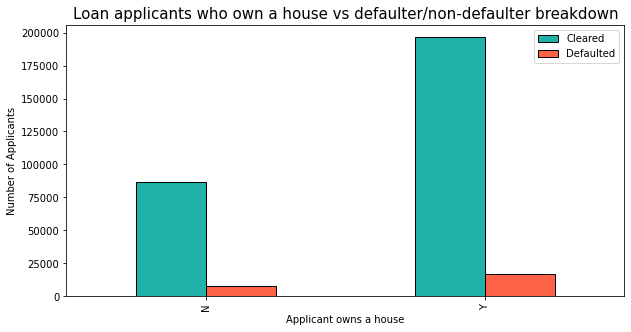

In [67]:
pivot = pd.pivot(data=df_house,index=['FLAG_OWN_REALTY'],columns=['TARGET'],values='Count')
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(color =['lightseagreen', 'tomato'], figsize=(10,5),width=0.5,edgecolor='black')
ax.set_title('Loan applicants who own a house vs defaulter/non-defaulter breakdown', fontsize=15)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Applicant owns a house', ylabel='Number of Applicants')
ax.legend(['Cleared','Defaulted'])
# ax.show()

### 0.2.12. Here we can observe a trend that is interstingly the opposite of our previous result, wherein people not having cars applied more for loans, but in this case, people who own a house tend to have applied for loans more often

### 0.2.13. Normalized Version


In [68]:
df_house = application_train[['FLAG_OWN_REALTY','TARGET']]

df_house = df_house.groupby('FLAG_OWN_REALTY')['TARGET'].value_counts(normalize=True).reset_index(name='Count')

df_house

,FLAG_OWN_REALTY,TARGET,Count
0,N,0,0.916751
1,N,1,0.083249
2,Y,0,0.920384
3,Y,1,0.079616


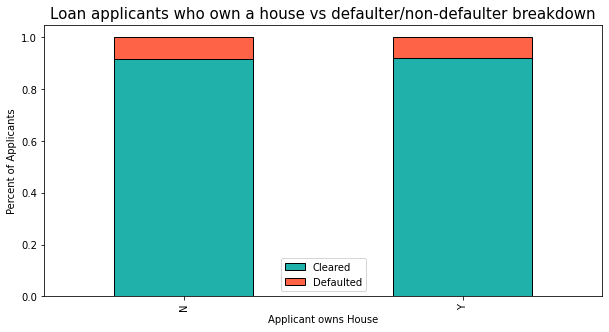

In [69]:
pivot = pd.pivot(data=df_house,index=['FLAG_OWN_REALTY'],columns=['TARGET'],values='Count')
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(color =['lightseagreen', 'tomato'], figsize=(10,5),width=0.5,edgecolor='black',stacked=True)
ax.set_title('Loan applicants who own a house vs defaulter/non-defaulter breakdown', fontsize=15)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Applicant owns House', ylabel='Percent of Applicants')
ax.legend(['Cleared','Defaulted'])
# ax.show()

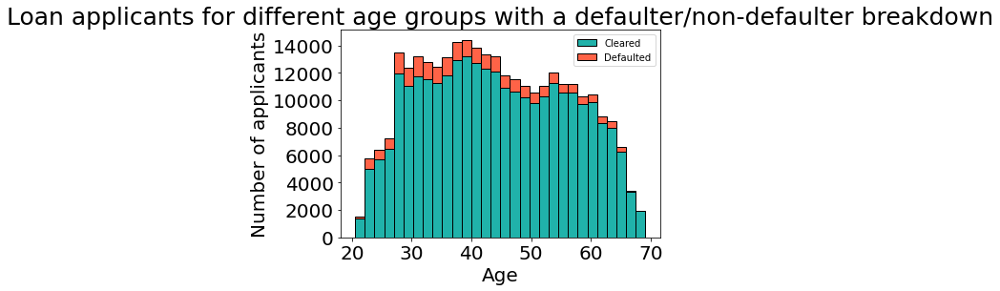

In [70]:
# Reference : https://stackoverflow.com/questions/24594511/creating-stacked-histogram-with-pandas-dataframes-data-python
plt.hist([application_train[(application_train['TARGET']==0)]['DAYS_BIRTH']/-365,application_train[application_train['TARGET']==1]['DAYS_BIRTH']/-365],bins=30,stacked=True,edgecolor='black',label=['Cleared','Defaulted'],color =['lightseagreen', 'tomato'])
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
plt.legend(fontsize=10)
plt.rcParams["figure.figsize"] = (15,8)
plt.title('Loan applicants for different age groups with a defaulter/non-defaulter breakdown',fontsize=25)
plt.xlabel('Age',fontsize=20)
plt.ylabel('Number of applicants',fontsize=20)
plt.show()

### 0.2.15. Based on the ages it is evident that people from the ages of 28 - 45 have the highes rate of defaulting on their loan payments and that reduces with the increase in age, almost becoming zero past the age of 65.

### 0.2.16. Let us perform the same kind of exploration with respect to the occupation of applicants

In [71]:
df_profession = application_train[['OCCUPATION_TYPE','TARGET']]

df_profession = df_profession.value_counts().reset_index(name='Count')

pivot = pd.pivot(data=df_profession,index=['OCCUPATION_TYPE'],columns=['TARGET'],values='Count')

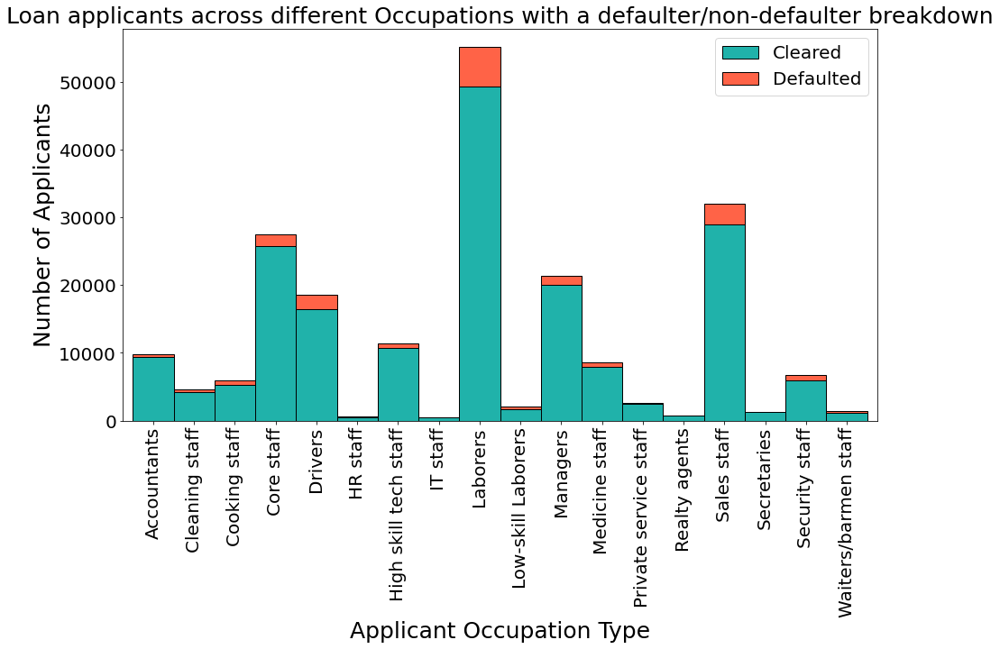

In [72]:
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(stacked=True, color =['lightseagreen', 'tomato'], figsize=(15,8),width=1,edgecolor='black',label=['Cleared','Defaulted'])
ax.set_title('Loan applicants across different Occupations with a defaulter/non-defaulter breakdown',size=25)

ax.set(xlabel='Applicant Occupation Type', ylabel='Number of Applicants')
ax.set_xlabel('Applicant Occupation Type', size = 25)
ax.set_ylabel('Number of Applicants', size = 25)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
ax.legend(['Cleared','Defaulted'],fontsize=20)


### 0.2.17. Here we can clearly observe that there are a massive amount of applicants who are laborers and they have a large amount of defaulters

### 0.2.18. IT and HR staff and Realty agents seem to have the least amount of loan applicants.

### 0.2.19. Here we can clearly observe that there are a massive amount of applicants who are laborers and they have a large amount of defaulters but the largest percentage of defaulters tend to belong to the low-skilled laborers

In [73]:
df_profession = application_train[['OCCUPATION_TYPE','TARGET']]

df_profession = df_profession.groupby('OCCUPATION_TYPE')['TARGET'].value_counts(normalize=True).reset_index(name='Count')

pivot = pd.pivot(data=df_profession,index=['OCCUPATION_TYPE'],columns=['TARGET'],values='Count')

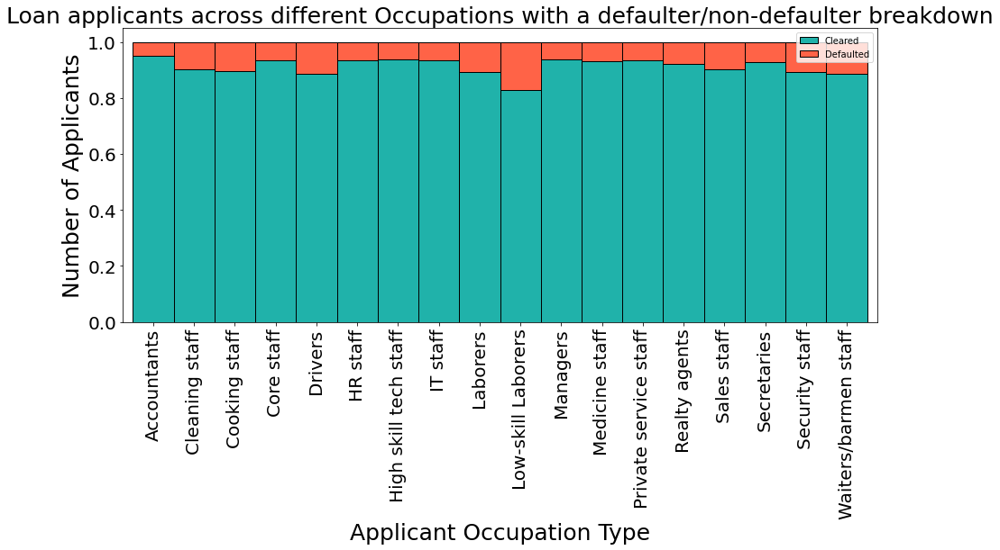

In [74]:
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(stacked=True, color =['lightseagreen', 'tomato'], figsize=(15,6),width=1,edgecolor='black',label=['Cleared','Defaulted'])
ax.set_title('Loan applicants across different Occupations with a defaulter/non-defaulter breakdown', fontsize=25)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Applicant Occupation Type', ylabel='Percent of Applicants')
ax.set_xlabel('Applicant Occupation Type', size = 25)
ax.set_ylabel('Number of Applicants', size = 25)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
ax.legend(['Cleared','Defaulted'])
# ax.show()

In [75]:
df_profession = application_train[['NAME_EDUCATION_TYPE','TARGET']]

df_profession = df_profession.value_counts().reset_index(name='Count')

pivot = pd.pivot(data=df_profession,index=['NAME_EDUCATION_TYPE'],columns=['TARGET'],values='Count')

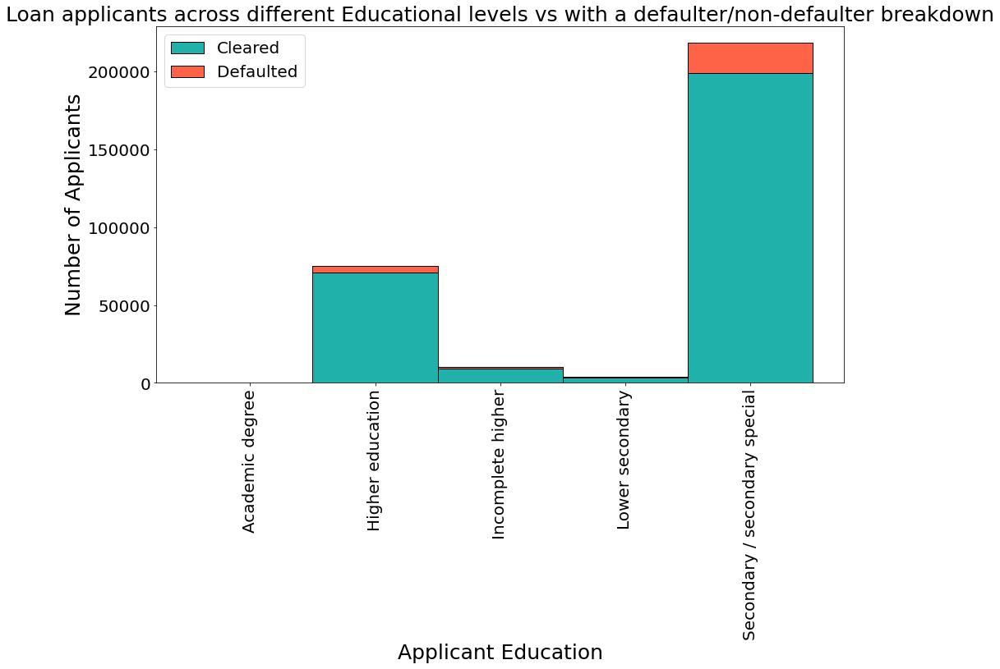

In [76]:
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(stacked=True, color =['lightseagreen', 'tomato'], figsize=(15,8),width=1,edgecolor='black',label=['Cleared','Defaulted'])
ax.set_title('Loan applicants across different Educational levels vs with a defaulter/non-defaulter breakdown',size=25)

ax.set(xlabel='Education', ylabel='Number of Applicants')
ax.set_xlabel('Applicant Education', size = 25)
ax.set_ylabel('Number of Applicants', size = 25)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
ax.legend(['Cleared','Defaulted'],fontsize=20)


In [77]:
df_profession = application_train[['NAME_EDUCATION_TYPE','TARGET']]

df_profession = df_profession.groupby('NAME_EDUCATION_TYPE')['TARGET'].value_counts(normalize=True).reset_index(name='Count')

pivot = pd.pivot(data=df_profession,index=['NAME_EDUCATION_TYPE'],columns=['TARGET'],values='Count')

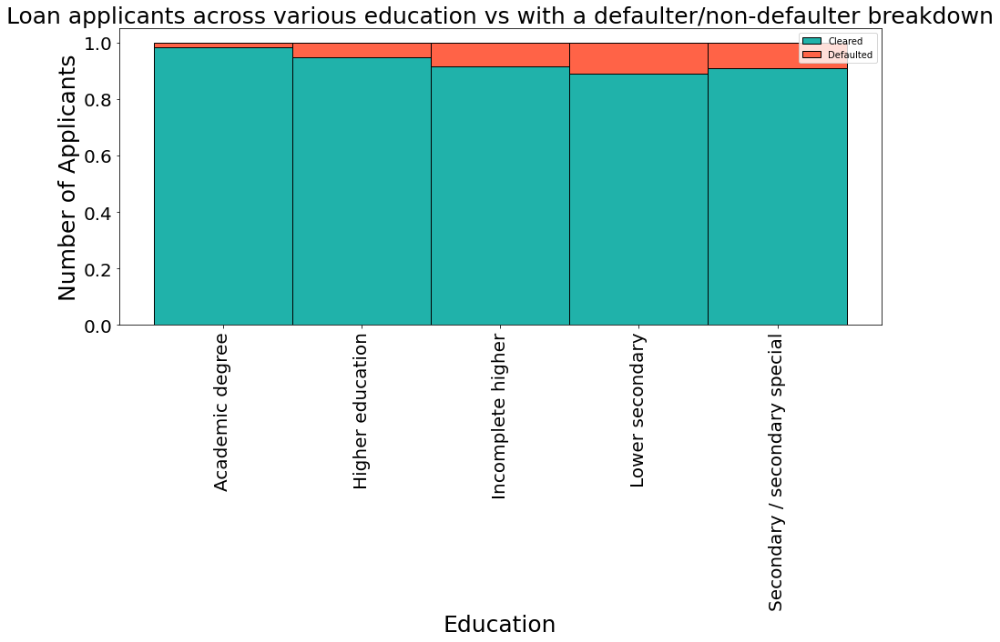

In [78]:
#ref : https://medium.com/@jb.ranchana/easy-way-to-create-stacked-bar-graphs-from-dataframe-19cc97c86fe3
ax = pivot.plot.bar(stacked=True, color =['lightseagreen', 'tomato'], figsize=(15,6),width=1,edgecolor='black',label=['Cleared','Defaulted'])
ax.set_title('Loan applicants across various education vs with a defaulter/non-defaulter breakdown', fontsize=25)
# ax.xlabel('Applicant Occupation Type')
# ax.xlabel('Number of Applicants')
ax.set(xlabel='Education', ylabel='Percent of Applicants')
ax.set_xlabel('Education', size = 25)
ax.set_ylabel('Number of Applicants', size = 25)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(20) 
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(20)
ax.legend(['Cleared','Defaulted'])
# ax.show()

### pair plots

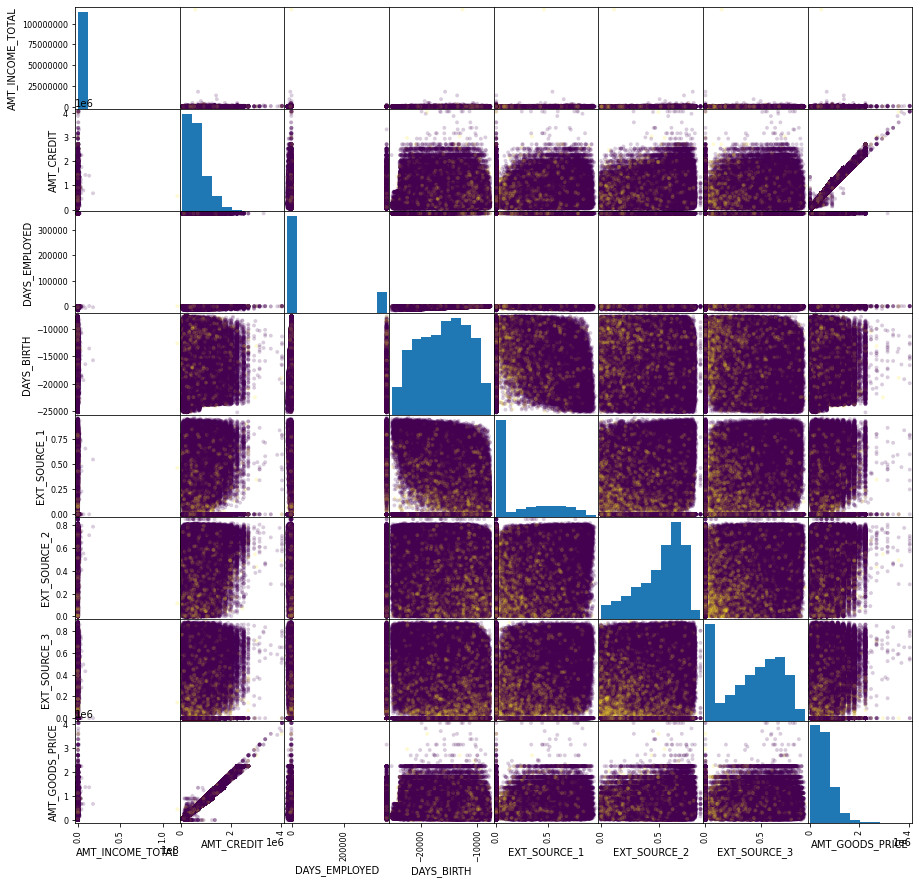

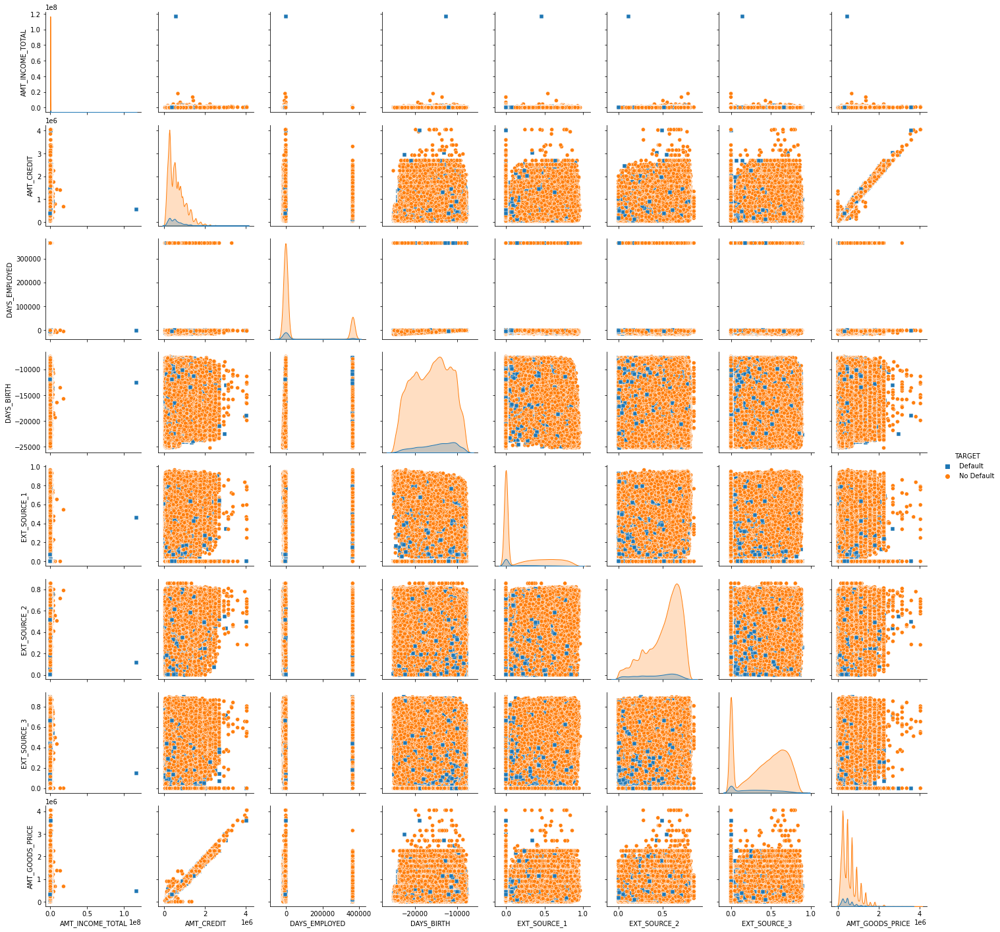

In [38]:
run = True
if run: 
    df_name = 'application_train'
    num_attribs = ['TARGET', 'AMT_INCOME_TOTAL',  'AMT_CREDIT', 'DAYS_EMPLOYED',
                       'DAYS_BIRTH', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'AMT_GOODS_PRICE']
    df = datasets[df_name].copy()
    df2 = df[num_attribs]

    # Scatter-plot
    df2.fillna(0, inplace=True)
    #    print('Numerical variables - Scatter-Matrix')
    grr = pd.plotting.scatter_matrix(df2.loc[:, df2.columns != 'TARGET'], 
                                     c = datasets[df_name]['TARGET'], 
                                     figsize=(15, 15), marker='.',
                                hist_kwds={'bins': 10}, s=60, alpha=.2)


    # Pair-plot
    df2['TARGET'].replace(0, "No Default", inplace=True)
    df2['TARGET'].replace(1, "Default", inplace=True)
    #    print('Numerical variables - Pair-Plot')    
    num_sns = sns.pairplot(df2, hue="TARGET", markers=["s", "o"])

# Dataset questions
## Unique record for each SK_ID_CURR

In [11]:
datasets.keys()

dict_keys(['application_train', 'application_test', 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 'previous_application', 'POS_CASH_balance'])

In [12]:
len(datasets["application_train"]["SK_ID_CURR"].unique()) == datasets["application_train"].shape[0]

True

In [13]:
np.intersect1d(datasets["application_train"]["SK_ID_CURR"], datasets["application_test"]["SK_ID_CURR"])

array([], dtype=int64)

In [14]:
datasets["application_test"].shape

(48744, 121)

In [15]:
datasets["application_train"].shape

(307511, 122)

## previous applications for the submission file
The persons in the kaggle submission file have had previous applications in the `previous_application.csv`. 47,800 out 48,744 people have had previous appications.

In [16]:
appsDF = datasets['previous_application']

In [17]:
appsDF.shape

(1670214, 37)

In [18]:
len(np.intersect1d(appsDF["SK_ID_CURR"],datasets['application_test']["SK_ID_CURR"]))

47800

In [19]:
print(f"There are  {appsDF.shape[0]:,} previous applications")

There are  1,670,214 previous applications


In [20]:
# How many entries are there for each month?
prevAppCounts = appsDF['SK_ID_CURR'].value_counts(dropna=False)


In [21]:
len(prevAppCounts[prevAppCounts >40])  #more that 40 previous applications

101

In [22]:
prevAppCounts[prevAppCounts >50].plot(kind='bar')
plt.xticks(rotation=100)
plt.xlabel('ID')
plt.ylabel('Counts')
plt.title('Applicants with more than 50 applications')
plt.show()

### Histogram of Number of previous applications for an ID

In [23]:
sum(appsDF['SK_ID_CURR'].value_counts()==1)

60458

In [24]:
plt.hist(appsDF['SK_ID_CURR'].value_counts(), cumulative =True, bins = 100);
plt.grid()
plt.ylabel('cumulative number of IDs')
plt.xlabel('Number of previous applications per ID')
plt.title('Histogram of Number of previous applications for an ID')


Text(0.5, 1.0, 'Histogram of Number of previous applications for an ID')

##### **Can we differentiate applications by low, medium and high previous apps?**
    * Low = <5 claims (22%)
    * Medium = 10 to 39 claims (58%)
    * High = 40 or more claims (20%)

In [25]:
apps_all = appsDF['SK_ID_CURR'].nunique()
apps_5plus = appsDF['SK_ID_CURR'].value_counts()>=5
apps_40plus = appsDF['SK_ID_CURR'].value_counts()>=40
print('Percentage with 10 or more previous apps:', np.round(100.*(sum(apps_5plus)/apps_all),5))
print('Percentage with 40 or more previous apps:', np.round(100.*(sum(apps_40plus)/apps_all),5))

Percentage with 10 or more previous apps: 41.76895
Percentage with 40 or more previous apps: 0.03453


# Joining secondary tables with the primary table

In the case of the HCDR competition (and many other machine learning problems that involve multiple tables in 3NF or not)  we need to join these datasets (denormalize) when using a machine learning pipeline. Joining the secondary tables with the primary table will lead to lots of new features about each loan application; these features will tend to be aggregate type features or meta data about the loan or its application. How can we do this when using Machine Learning Pipelines?

## Joining `previous_application` with `application_x`
We refer to the `application_train` data (and also `application_test` data also) as the **primary table** and the other files as the **secondary tables** (e.g., `previous_application` dataset). All tables can be joined using the primary key `SK_ID_PREV`.

Let's assume we wish to generate a feature based on previous application attempts. In this case, possible features here could be:

* A simple feature could be the number of previous applications.
* Other summary features of original features such as `AMT_APPLICATION`, `AMT_CREDIT` could be based on average, min, max, median, etc.
 
To build such features, we need to join the `application_train` data (and also `application_test` data also) with the 'previous_application' dataset (and the other available datasets).

When joining this data in the context of pipelines, different strategies come to mind with various tradeoffs:

1. Preprocess each of the non-application data sets, thereby generating many new (derived) features, and then joining (aka merge) the results with the `application_train` data (the labeled dataset) and with the `application_test` data (the unlabeled submission dataset) prior to processing the data (in a train, valid, test partition) via your machine learning pipeline. [This approach is recommended for this HCDR competition. WHY?]

* Do the joins as part of the transformation steps. [Not recommended here. WHY?]. How can this be done? Will it work?
  * This would be necessary if we had dataset wide features such as IDF (inverse document frequency) which depend on the entire subset of data as opposed to a single loan application (e.g., a feature about the relative amount applied for such as the percentile of the loan amount being applied for).
 
I want you to think about this section and build on this.

## Roadmap for secondary table processing

1. Transform all the secondary tables to features that can be joined into the main table the application table (labeled and unlabeled)
   * 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 
   * 'previous_application', 'POS_CASH_balance'
* Merge the transformed secondary tables with the primary tables (i.e., the `application_train` data (the labeled dataset) and with the `application_test` data (the unlabeled submission dataset)), thereby leading to X_train, y_train, X_valid, etc.
* Proceed with the learning pipeline using X_train, y_train, X_valid, etc.
* Generate a submission file using the learnt model


### Multiple condition expressions in Pandas
So far, both our boolean selections have involved a single condition. You can, of course, have as many conditions as you would like. To do so, you will need to combine your boolean expressions using the three logical operators and, or and not.

Use &, | , ~
Although Python uses the syntax and, or, and not, these will not work when testing multiple conditions with pandas. The details of why are explained [here](https://medium.com/dunder-data/selecting-subsets-of-data-in-pandas-39e811c81a0c).

You must use the following operators with pandas:

* & for and
* | for or
* ~ for not

In [26]:
appsDF[0:50][(appsDF["SK_ID_CURR"]==175704)]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
6,2315218,175704,Cash loans,NaN,0.0,0.0,NaN,NaN,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Canceled,-14,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN


In [27]:
appsDF[0:50][(appsDF["SK_ID_CURR"]==175704) & ~(appsDF["AMT_CREDIT"]==1.0)]

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
6,2315218,175704,Cash loans,NaN,0.0,0.0,NaN,NaN,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Canceled,-14,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN


## Missing values in prevApps

In [28]:
appsDF.isna().sum()

SK_ID_PREV                           0
SK_ID_CURR                           0
NAME_CONTRACT_TYPE                   0
AMT_ANNUITY                     372235
AMT_APPLICATION                      0
AMT_CREDIT                           1
AMT_DOWN_PAYMENT                895844
AMT_GOODS_PRICE                 385515
WEEKDAY_APPR_PROCESS_START           0
HOUR_APPR_PROCESS_START              0
FLAG_LAST_APPL_PER_CONTRACT          0
NFLAG_LAST_APPL_IN_DAY               0
RATE_DOWN_PAYMENT               895844
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
NAME_CASH_LOAN_PURPOSE               0
NAME_CONTRACT_STATUS                 0
DAYS_DECISION                        0
NAME_PAYMENT_TYPE                    0
CODE_REJECT_REASON                   0
NAME_TYPE_SUITE                 820405
NAME_CLIENT_TYPE                     0
NAME_GOODS_CATEGORY                  0
NAME_PORTFOLIO                       0
NAME_PRODUCT_TYPE                    0
CHANNEL_TYPE             

In [29]:
appsDF.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'NAME_CASH_LOAN_PURPOSE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL'],
      dtype='object')

# Feature Engineering

## feature engineering for prevApp table

In [30]:
features = ['AMT_ANNUITY', 'AMT_APPLICATION']
agg_op_features = {}
cols = []
agg_func_list=["mean", "min", "max"]

for f in features: #build agg dictionary
    agg_op_features[f] = agg_func_list
    cols.append(f"{f}_{func}" for func in agg_func_list)

print(agg_op_features)
print(f"{appsDF[features].describe()}")
print()

result = appsDF.groupby('SK_ID_CURR').agg(agg_op_features)

result.columns = ["_".join(x) for x in result.columns.ravel()]
result = result.reset_index(level=["SK_ID_CURR"])
result['range_AMT_APPLICATION'] = result['AMT_APPLICATION_max'] - result['AMT_APPLICATION_min']
print(f"result.shape: {result.shape}")
result.head(10)

{'AMT_ANNUITY': ['mean', 'min', 'max'], 'AMT_APPLICATION': ['mean', 'min', 'max']}
        AMT_ANNUITY  AMT_APPLICATION
count  1.297979e+06     1.670214e+06
mean   1.595512e+04     1.752339e+05
std    1.478214e+04     2.927798e+05
min    0.000000e+00     0.000000e+00
25%    6.321780e+03     1.872000e+04
50%    1.125000e+04     7.104600e+04
75%    2.065842e+04     1.803600e+05
max    4.180581e+05     6.905160e+06

result.shape: (338857, 8)


,SK_ID_CURR,AMT_ANNUITY_mean,AMT_ANNUITY_min,AMT_ANNUITY_max,AMT_APPLICATION_mean,AMT_APPLICATION_min,AMT_APPLICATION_max,range_AMT_APPLICATION
0,100001,3951.000000,3951.000,3951.000,24835.500000,24835.5,24835.5,0.0
1,100002,9251.775000,9251.775,9251.775,179055.000000,179055.0,179055.0,0.0
2,100003,56553.990000,6737.310,98356.995,435436.500000,68809.5,900000.0,831190.5
3,100004,5357.250000,5357.250,5357.250,24282.000000,24282.0,24282.0,0.0
4,100005,4813.200000,4813.200,4813.200,22308.750000,0.0,44617.5,44617.5
5,100006,23651.175000,2482.920,39954.510,272203.260000,0.0,688500.0,688500.0
6,100007,12278.805000,1834.290,22678.785,150530.250000,17176.5,247500.0,230323.5
7,100008,15839.696250,8019.090,25309.575,155701.800000,0.0,450000.0,450000.0
8,100009,10051.412143,7435.845,17341.605,76741.714286,40455.0,110160.0,69705.0
9,100010,27463.410000,27463.410,27463.410,247212.000000,247212.0,247212.0,0.0


In [31]:
result.isna().sum()

SK_ID_CURR                 0
AMT_ANNUITY_mean         480
AMT_ANNUITY_min          480
AMT_ANNUITY_max          480
AMT_APPLICATION_mean       0
AMT_APPLICATION_min        0
AMT_APPLICATION_max        0
range_AMT_APPLICATION      0
dtype: int64

## feature transformer for prevApp table

In [32]:
# Create aggregate features (via pipeline)
class prevAppsFeaturesAggregater(BaseEstimator, TransformerMixin):
    def __init__(self, features=None): # no *args or **kargs
        self.features = features
        self.agg_op_features = {}
        for f in features:
#             self.agg_op_features[f] = {f"{f}_{func}":func for func in ["min", "max", "mean"]}
            self.agg_op_features[f] =  ["min", "max", "mean"]

    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        #from IPython.core.debugger import Pdb as pdb;    pdb().set_trace() #breakpoint; dont forget to quit         
        result = X.groupby(["SK_ID_CURR"]).agg(self.agg_op_features)
#         result.columns = result.columns.droplevel()
        result.columns = ["_".join(x) for x in result.columns.ravel()]

        result = result.reset_index(level=["SK_ID_CURR"])
        result['range_AMT_APPLICATION'] = result['AMT_APPLICATION_max'] - result['AMT_APPLICATION_min']
        return result # return dataframe with the join key "SK_ID_CURR"
    

from sklearn.pipeline import make_pipeline 
def test_driver_prevAppsFeaturesAggregater(df, features):
    print(f"df.shape: {df.shape}\n")
    print(f"df[{features}][0:5]: \n{df[features][0:5]}")
    test_pipeline = make_pipeline(prevAppsFeaturesAggregater(features))
    return(test_pipeline.fit_transform(df))
         
features = ['AMT_ANNUITY', 'AMT_APPLICATION']
features = ['AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CNT_PAYMENT', 
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION']
features = ['AMT_ANNUITY', 'AMT_APPLICATION']
res = test_driver_prevAppsFeaturesAggregater(appsDF, features)
print(f"HELLO")
print(f"Test driver: \n{res[0:10]}")
print(f"input[features][0:10]: \n{appsDF[0:10]}")


# QUESTION, should we lower case df['OCCUPATION_TYPE'] as Sales staff != 'Sales Staff'? (hint: YES)

df.shape: (1670214, 37)

df[['AMT_ANNUITY', 'AMT_APPLICATION']][0:5]: 
   AMT_ANNUITY  AMT_APPLICATION
0     1730.430          17145.0
1    25188.615         607500.0
2    15060.735         112500.0
3    47041.335         450000.0
4    31924.395         337500.0
HELLO
Test driver: 
   SK_ID_CURR  AMT_ANNUITY_min  AMT_ANNUITY_max  AMT_ANNUITY_mean  \
0      100001         3951.000         3951.000       3951.000000   
1      100002         9251.775         9251.775       9251.775000   
2      100003         6737.310        98356.995      56553.990000   
3      100004         5357.250         5357.250       5357.250000   
4      100005         4813.200         4813.200       4813.200000   
5      100006         2482.920        39954.510      23651.175000   
6      100007         1834.290        22678.785      12278.805000   
7      100008         8019.090        25309.575      15839.696250   
8      100009         7435.845        17341.605      10051.412143   
9      100010        27463.

9                        NaN  


### Feature Engineering for Primary & Secondary Tables

Choosing Highly correlated features from all input datasets

In [33]:
def correlation_files_target(df_name):
    A = datasets['application_train'].copy()
    B = datasets[df_name].copy()
    correlation_matrix =  pd.concat([A.TARGET, B], axis=1).corr().filter(B.columns).filter(A.columns, axis=0)
    return correlation_matrix

In [34]:
df_name = 'previous_application'
correlation_matrix = correlation_files_target(df_name)
print(f"Correlation of the {df_name} against the Target is :")
correlation_matrix.T.TARGET.sort_values(ascending= False)

Correlation of the previous_application against the Target is :


AMT_DOWN_PAYMENT             0.002496
CNT_PAYMENT                  0.002341
DAYS_LAST_DUE_1ST_VERSION    0.001908
AMT_CREDIT                   0.001833
AMT_APPLICATION              0.001689
AMT_GOODS_PRICE              0.001676
SK_ID_CURR                   0.001107
NFLAG_INSURED_ON_APPROVAL    0.000879
RATE_DOWN_PAYMENT            0.000850
RATE_INTEREST_PRIMARY        0.000542
SK_ID_PREV                   0.000362
DAYS_DECISION               -0.000482
AMT_ANNUITY                 -0.000492
DAYS_FIRST_DUE              -0.000943
SELLERPLACE_AREA            -0.000954
DAYS_TERMINATION            -0.001072
NFLAG_LAST_APPL_IN_DAY      -0.001256
DAYS_FIRST_DRAWING          -0.001293
DAYS_LAST_DUE               -0.001940
HOUR_APPR_PROCESS_START     -0.002285
RATE_INTEREST_PRIVILEGED    -0.026427
Name: TARGET, dtype: float64

In [35]:
df_name = 'bureau'
correlation_matrix = correlation_files_target(df_name)
print(f"Correlation of the {df_name} against the Target is :")
correlation_matrix.T.TARGET.sort_values(ascending= False)

Correlation of the bureau against the Target is :


DAYS_CREDIT_UPDATE        0.002159
DAYS_CREDIT_ENDDATE       0.002048
SK_ID_BUREAU              0.001550
DAYS_CREDIT               0.001443
AMT_CREDIT_SUM            0.000218
DAYS_ENDDATE_FACT         0.000203
AMT_ANNUITY               0.000189
AMT_CREDIT_MAX_OVERDUE   -0.000389
CNT_CREDIT_PROLONG       -0.000495
AMT_CREDIT_SUM_LIMIT     -0.000558
AMT_CREDIT_SUM_DEBT      -0.000946
SK_ID_CURR               -0.001070
AMT_CREDIT_SUM_OVERDUE   -0.001464
CREDIT_DAY_OVERDUE       -0.001815
Name: TARGET, dtype: float64

In [36]:
df_name = 'bureau_balance'
correlation_matrix = correlation_files_target(df_name)
print(f"Correlation of the {df_name} against the Target is :")
correlation_matrix.T.TARGET.sort_values(ascending= False)

Correlation of the bureau_balance against the Target is :


SK_ID_BUREAU      0.001223
MONTHS_BALANCE   -0.005262
Name: TARGET, dtype: float64

In [37]:
df_name = 'credit_card_balance'
correlation_matrix = correlation_files_target(df_name)
print(f"Correlation of the {df_name} against the Target is :")
correlation_matrix.T.TARGET.sort_values(ascending= False)

Correlation of the credit_card_balance against the Target is :


CNT_DRAWINGS_ATM_CURRENT      0.001908
AMT_DRAWINGS_ATM_CURRENT      0.001520
AMT_INST_MIN_REGULARITY       0.001435
SK_ID_CURR                    0.001086
AMT_CREDIT_LIMIT_ACTUAL       0.000515
AMT_BALANCE                   0.000448
SK_ID_PREV                    0.000446
AMT_RECIVABLE                 0.000412
AMT_TOTAL_RECEIVABLE          0.000407
AMT_RECEIVABLE_PRINCIPAL      0.000383
SK_DPD                        0.000092
SK_DPD_DEF                   -0.000201
CNT_INSTALMENT_MATURE_CUM    -0.000342
MONTHS_BALANCE               -0.000768
AMT_PAYMENT_CURRENT          -0.001129
AMT_PAYMENT_TOTAL_CURRENT    -0.001395
AMT_DRAWINGS_CURRENT         -0.001419
CNT_DRAWINGS_CURRENT         -0.001764
CNT_DRAWINGS_OTHER_CURRENT   -0.001833
CNT_DRAWINGS_POS_CURRENT     -0.002387
AMT_DRAWINGS_OTHER_CURRENT   -0.002672
AMT_DRAWINGS_POS_CURRENT     -0.003518
Name: TARGET, dtype: float64

### Adding new Statistical Features

In [38]:
agg_funcs = ['min', 'max','median','mean', 'count', 'sum']

prevApps = datasets['previous_application']
prevApps_features = ['AMT_ANNUITY', 'AMT_APPLICATION']

bureau = datasets['bureau']
bureau_features = ['AMT_ANNUITY', 'AMT_CREDIT_SUM']
# bureau_funcs = ['min', 'max', 'mean', 'count', 'sum']

bureau_bal = datasets['bureau_balance']
bureau_bal_features = ['MONTHS_BALANCE']

cc_bal = datasets['credit_card_balance']
cc_bal_features = ['MONTHS_BALANCE', 'AMT_BALANCE', 'CNT_INSTALMENT_MATURE_CUM']

installments_pmnts = datasets['installments_payments']
installments_pmnts_features = ['AMT_INSTALMENT', 'AMT_PAYMENT']

### Feature Aggregator

In [39]:
# Pipelines
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import make_pipeline, Pipeline, FeatureUnion
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder


class FeaturesAggregator(BaseEstimator, TransformerMixin):
    def __init__(self, file_name=None, features=None, funcs=None): # no *args or **kargs
        self.file_name = file_name
        self.features = features
        self.funcs = funcs
        self.agg_op_features = {}
        for f in self.features:
            temp = {f"{file_name}_{f}_{func}":func for func in self.funcs}
            self.agg_op_features[f]=[(k, v) for k, v in temp.items()]
        print(self.agg_op_features)
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        #from IPython.core.debugger import Pdb as pdb;    pdb().set_trace() #breakpoint; dont forget to quit         
        result = X.groupby(["SK_ID_CURR"]).agg(self.agg_op_features)
        result.columns = result.columns.droplevel()
        result = result.reset_index(level=["SK_ID_CURR"])
        return result # return dataframe with the join key "SK_ID_CURR"

In [40]:
class engineer_features(BaseEstimator, TransformerMixin):
    def __init__(self, features=None):
        self
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):

# FROM APPLICATION
        # ADD INCOME CREDIT PERCENTAGE
        X['ef_INCOME_CREDIT_PERCENT'] = (
            X.AMT_INCOME_TOTAL / X.AMT_CREDIT).replace(np.inf, 0)
    
        # ADD INCOME PER FAMILY MEMBER
        X['ef_FAM_MEMBER_INCOME'] = (
            X.AMT_INCOME_TOTAL / X.CNT_FAM_MEMBERS).replace(np.inf, 0)
    
        # ADD ANNUITY AS PERCENTAGE OF ANNUAL INCOME
        X['ef_ANN_INCOME_PERCENT'] = (
            X.AMT_ANNUITY / X.AMT_INCOME_TOTAL).replace(np.inf, 0)    

        return X

In [41]:
from sklearn.pipeline import make_pipeline, Pipeline, FeatureUnion

prevApps_feature_pipeline = Pipeline([
    ('prevApps_aggregator', FeaturesAggregator('prevApps', prevApps_features, agg_funcs)), # Aggregate across old and new features
    ])

bureau_feature_pipeline = Pipeline([
    ('bureau_aggregator', FeaturesAggregator('bureau', bureau_features, agg_funcs)), # Aggregate across old and new features
    ])

bureau_bal_features_pipeline = Pipeline([
    ('bureau_bal_aggregator', FeaturesAggregator('bureau_balance', bureau_bal_features , agg_funcs)), # Aggregate across old and new features
    ])

cc_bal_features_pipeline = Pipeline([
    ('cc_bal_aggregator', FeaturesAggregator('credit_card_balance', cc_bal_features , agg_funcs)), # Aggregate across old and new features
    ])

installments_pmnts_features_pipeline = Pipeline([
    ('installments_pmnts_features_aggregator', FeaturesAggregator('credit_card_balance', installments_pmnts_features , agg_funcs)), # Aggregate across old and new features
    ])

# Feature engineering pipeline for application_train
appln_feature_pipeline = Pipeline([
    ('engineer_features', engineer_features()),  # add some new features
    ])

{'AMT_ANNUITY': [('prevApps_AMT_ANNUITY_min', 'min'), ('prevApps_AMT_ANNUITY_max', 'max'), ('prevApps_AMT_ANNUITY_median', 'median'), ('prevApps_AMT_ANNUITY_mean', 'mean'), ('prevApps_AMT_ANNUITY_count', 'count'), ('prevApps_AMT_ANNUITY_sum', 'sum')], 'AMT_APPLICATION': [('prevApps_AMT_APPLICATION_min', 'min'), ('prevApps_AMT_APPLICATION_max', 'max'), ('prevApps_AMT_APPLICATION_median', 'median'), ('prevApps_AMT_APPLICATION_mean', 'mean'), ('prevApps_AMT_APPLICATION_count', 'count'), ('prevApps_AMT_APPLICATION_sum', 'sum')]}
{'AMT_ANNUITY': [('bureau_AMT_ANNUITY_min', 'min'), ('bureau_AMT_ANNUITY_max', 'max'), ('bureau_AMT_ANNUITY_median', 'median'), ('bureau_AMT_ANNUITY_mean', 'mean'), ('bureau_AMT_ANNUITY_count', 'count'), ('bureau_AMT_ANNUITY_sum', 'sum')], 'AMT_CREDIT_SUM': [('bureau_AMT_CREDIT_SUM_min', 'min'), ('bureau_AMT_CREDIT_SUM_max', 'max'), ('bureau_AMT_CREDIT_SUM_median', 'median'), ('bureau_AMT_CREDIT_SUM_mean', 'mean'), ('bureau_AMT_CREDIT_SUM_count', 'count'), ('bureau

### Storing Dataset in variables

In [42]:
df_appsTrain = datasets['application_train']
df_prevApps = datasets["previous_application"] 
df_bureau = datasets["bureau"] 
df_bureau_bal = datasets['bureau_balance']
df_cc_bal = datasets["credit_card_balance"] 
df_installments_payments = datasets["installments_payments"] 

### Fit Feature Engineering Pipeline

In [43]:
df_appsTrain = appln_feature_pipeline.fit_transform(df_appsTrain)
prevApps_agg = prevApps_feature_pipeline.fit_transform(df_prevApps)
bureau_agg = bureau_feature_pipeline.fit_transform(df_bureau)

ccblance_agg = cc_bal_features_pipeline.fit_transform(df_cc_bal)
installments_payments_agg = installments_pmnts_features_pipeline.fit_transform(df_installments_payments)

In [44]:
installments_payments_agg.head()

,SK_ID_CURR,credit_card_balance_AMT_INSTALMENT_min,credit_card_balance_AMT_INSTALMENT_max,credit_card_balance_AMT_INSTALMENT_median,credit_card_balance_AMT_INSTALMENT_mean,credit_card_balance_AMT_INSTALMENT_count,credit_card_balance_AMT_INSTALMENT_sum,credit_card_balance_AMT_PAYMENT_min,credit_card_balance_AMT_PAYMENT_max,credit_card_balance_AMT_PAYMENT_median,credit_card_balance_AMT_PAYMENT_mean,credit_card_balance_AMT_PAYMENT_count,credit_card_balance_AMT_PAYMENT_sum
0,100001,3951.000,17397.900,3980.925,5885.132143,7,41195.925,3951.000,17397.900,3980.925,5885.132143,7,41195.925
1,100002,9251.775,53093.745,9251.775,11559.247105,19,219625.695,9251.775,53093.745,9251.775,11559.247105,19,219625.695
2,100003,6662.970,560835.360,64275.615,64754.586000,25,1618864.650,6662.970,560835.360,64275.615,64754.586000,25,1618864.650
3,100004,5357.250,10573.965,5357.250,7096.155000,3,21288.465,5357.250,10573.965,5357.250,7096.155000,3,21288.465
4,100005,4813.200,17656.245,4813.200,6240.205000,9,56161.845,4813.200,17656.245,4813.200,6240.205000,9,56161.845


### Join the labeled datasets

In [45]:
datasets.keys()

dict_keys(['application_train', 'application_test', 'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments', 'previous_application', 'POS_CASH_balance'])

In [46]:
merge_all_data = True

if merge_all_data:
    prevApps_agg = prevApps_feature_pipeline.transform(df_prevApps)

# merge primary table and secondary tables using features based on meta data and  aggregage stats 
if merge_all_data:
    df_appsTrain = df_appsTrain.merge(prevApps_agg, how='left', on='SK_ID_CURR')
    df_appsTrain = df_appsTrain.merge(bureau_agg, how='left', on="SK_ID_CURR")
    df_appsTrain = df_appsTrain.merge(ccblance_agg, how='left', on="SK_ID_CURR")
    df_appsTrain = df_appsTrain.merge(installments_payments_agg, how='left', on="SK_ID_CURR")


In [47]:
print(df_appsTrain.shape)
df_appsTrain.head(3)


(307511, 179)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,...,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,ef_INCOME_CREDIT_PERCENT,ef_FAM_MEMBER_INCOME,ef_ANN_INCOME_PERCENT,prevApps_AMT_ANNUITY_min,prevApps_AMT_ANNUITY_max,prevApps_AMT_ANNUITY_median,prevApps_AMT_ANNUITY_mean,prevApps_AMT_ANNUITY_count,prevApps_AMT_ANNUITY_sum,prevApps_AMT_APPLICATION_min,prevApps_AMT_APPLICATION_max,prevApps_AMT_APPLICATION_median,prevApps_AMT_APPLICATION_mean,prevApps_AMT_APPLICATION_count,prevApps_AMT_APPLICATION_sum,bureau_AMT_ANNUITY_min,bureau_AMT_ANNUITY_max,bureau_AMT_ANNUITY_median,bureau_AMT_ANNUITY_mean,bureau_AMT_ANNUITY_count,bureau_AMT_ANNUITY_sum,bureau_AMT_CREDIT_SUM_min,bureau_AMT_CREDIT_SUM_max,bureau_AMT_CREDIT_SUM_median,bureau_AMT_CREDIT_SUM_mean,bureau_AMT_CREDIT_SUM_count,bureau_AMT_CREDIT_SUM_sum,credit_card_balance_MONTHS_BALANCE_min,credit_card_balance_MONTHS_BALANCE_max,credit_card_balance_MONTHS_BALANCE_median,credit_card_balance_MONTHS_BALANCE_mean,credit_card_balance_MONTHS_BALANCE_count,credit_card_balance_MONTHS_BALANCE_sum,credit_card_balance_AMT_BALANCE_min,credit_card_balance_AMT_BALANCE_max,credit_card_balance_AMT_BALANCE_median,credit_card_balance_AMT_BALANCE_mean,credit_card_balance_AMT_BALANCE_count,credit_card_balance_AMT_BALANCE_sum,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_min,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_max,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_median,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_mean,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_count,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_sum,credit_card_balance_AMT_INSTALMENT_min,credit_card_balance_AMT_INSTALMENT_max,credit_card_balance_AMT_INSTALMENT_median,credit_card_balance_AMT_INSTALMENT_mean,credit_card_balance_AMT_INSTALMENT_count,credit_card_balance_AMT_INSTALMENT_sum,credit_card_balance_AMT_PAYMENT_min,credit_card_balance_AMT_PAYMENT_max,credit_card_balance_AMT_PAYMENT_median,credit_card_balance_AMT_PAYMENT_mean,credit_card_balance_AMT_PAYMENT_count,credit_card_balance_AMT_PAYMENT_sum
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.

### Join the test dataset to secondary datasets

In [48]:
kaggle_test= datasets["application_test"]
kaggle_test = appln_feature_pipeline.fit_transform(kaggle_test)

merge_all_data = True
if merge_all_data:
    kaggle_test = kaggle_test.merge(prevApps_agg, how='left', on='SK_ID_CURR')
    kaggle_test = kaggle_test.merge(bureau_agg, how='left', on="SK_ID_CURR")
    kaggle_test = kaggle_test.merge(ccblance_agg, how='left', on="SK_ID_CURR")
    kaggle_test = kaggle_test.merge(installments_payments_agg, how='left', on="SK_ID_CURR")
    

In [49]:
print(kaggle_test.shape)

kaggle_test.head(3)

(48744, 178)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,...,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,ef_INCOME_CREDIT_PERCENT,ef_FAM_MEMBER_INCOME,ef_ANN_INCOME_PERCENT,prevApps_AMT_ANNUITY_min,prevApps_AMT_ANNUITY_max,prevApps_AMT_ANNUITY_median,prevApps_AMT_ANNUITY_mean,prevApps_AMT_ANNUITY_count,prevApps_AMT_ANNUITY_sum,prevApps_AMT_APPLICATION_min,prevApps_AMT_APPLICATION_max,prevApps_AMT_APPLICATION_median,prevApps_AMT_APPLICATION_mean,prevApps_AMT_APPLICATION_count,prevApps_AMT_APPLICATION_sum,bureau_AMT_ANNUITY_min,bureau_AMT_ANNUITY_max,bureau_AMT_ANNUITY_median,bureau_AMT_ANNUITY_mean,bureau_AMT_ANNUITY_count,bureau_AMT_ANNUITY_sum,bureau_AMT_CREDIT_SUM_min,bureau_AMT_CREDIT_SUM_max,bureau_AMT_CREDIT_SUM_median,bureau_AMT_CREDIT_SUM_mean,bureau_AMT_CREDIT_SUM_count,bureau_AMT_CREDIT_SUM_sum,credit_card_balance_MONTHS_BALANCE_min,credit_card_balance_MONTHS_BALANCE_max,credit_card_balance_MONTHS_BALANCE_median,credit_card_balance_MONTHS_BALANCE_mean,credit_card_balance_MONTHS_BALANCE_count,credit_card_balance_MONTHS_BALANCE_sum,credit_card_balance_AMT_BALANCE_min,credit_card_balance_AMT_BALANCE_max,credit_card_balance_AMT_BALANCE_median,credit_card_balance_AMT_BALANCE_mean,credit_card_balance_AMT_BALANCE_count,credit_card_balance_AMT_BALANCE_sum,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_min,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_max,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_median,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_mean,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_count,credit_card_balance_CNT_INSTALMENT_MATURE_CUM_sum,credit_card_balance_AMT_INSTALMENT_min,credit_card_balance_AMT_INSTALMENT_max,credit_card_balance_AMT_INSTALMENT_median,credit_card_balance_AMT_INSTALMENT_mean,credit_card_balance_AMT_INSTALMENT_count,credit_card_balance_AMT_INSTALMENT_sum,credit_card_balance_AMT_PAYMENT_min,credit_card_balance_AMT_PAYMENT_max,credit_card_balance_AMT_PAYMENT_median,credit_card_balance_AMT_PAYMENT_mean,credit_card_balance_AMT_PAYMENT_count,credit_card_balance_AMT_PAYMENT_sum
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.066,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,N

In [50]:
df_appsTrain.dtypes.value_counts()

float64    122
int64       41
object      16
dtype: int64

In [51]:
correlation_with_all_features =df_appsTrain.corr()
correlation_with_all_features['TARGET'].sort_values()

EXT_SOURCE_3                               -0.178919
EXT_SOURCE_2                               -0.160472
EXT_SOURCE_1                               -0.155317
credit_card_balance_MONTHS_BALANCE_count   -0.060481
credit_card_balance_AMT_BALANCE_count      -0.060481
                                              ...   
credit_card_balance_AMT_BALANCE_max         0.068798
DAYS_BIRTH                                  0.078239
credit_card_balance_AMT_BALANCE_median      0.085281
credit_card_balance_AMT_BALANCE_mean        0.087177
TARGET                                      1.000000
Name: TARGET, Length: 163, dtype: float64

In [52]:
# set this value to choose the number of positive and negative correlated features
n_val = 10


print("---"*10)
print("---"*10)

print("    Total correlation of all the features.    " )

print("---"*10)
print("---"*10)

print(f"Top {n_val} negative correlated features")
print()
print(correlation_with_all_features.TARGET.sort_values(ascending = True).head(n_val))
print()
print()
print(f"Top {n_val} positive correlated features")
print()
print(correlation_with_all_features.TARGET.sort_values(ascending = True).tail(n_val))

------------------------------
------------------------------
    Total correlation of all the features.    
------------------------------
------------------------------
Top 10 negative correlated features

EXT_SOURCE_3                                          -0.178919
EXT_SOURCE_2                                          -0.160472
EXT_SOURCE_1                                          -0.155317
credit_card_balance_MONTHS_BALANCE_count              -0.060481
credit_card_balance_AMT_BALANCE_count                 -0.060481
credit_card_balance_CNT_INSTALMENT_MATURE_CUM_count   -0.055621
DAYS_EMPLOYED                                         -0.044932
FLOORSMAX_AVG                                         -0.044003
FLOORSMAX_MEDI                                        -0.043768
FLOORSMAX_MODE                                        -0.043226
Name: TARGET, dtype: float64


Top 10 positive correlated features

REGION_RATING_CLIENT_W_CITY                  0.060893
credit_card_balance_MONTHS_BAL

In [53]:
correlation_with_all_features.TARGET.sort_values(ascending = True)[-n_val:]

REGION_RATING_CLIENT_W_CITY                  0.060893
credit_card_balance_MONTHS_BALANCE_min       0.061359
credit_card_balance_MONTHS_BALANCE_mean      0.062081
credit_card_balance_MONTHS_BALANCE_median    0.062192
credit_card_balance_AMT_BALANCE_min          0.064163
credit_card_balance_AMT_BALANCE_max          0.068798
DAYS_BIRTH                                   0.078239
credit_card_balance_AMT_BALANCE_median       0.085281
credit_card_balance_AMT_BALANCE_mean         0.087177
TARGET                                       1.000000
Name: TARGET, dtype: float64

In [54]:
tf_apps_train_final = []

featureslist1 = correlation_with_all_features.TARGET.sort_values(ascending = True)[:n_val].index.tolist()
featureslist2 = correlation_with_all_features.TARGET.sort_values(ascending = True)[-n_val:].index.tolist()
tf_apps_train_final = featureslist1 + featureslist2
len(tf_apps_train_final)

20

In [55]:
modeling_num_attrib = []
modeling_cat_attrib = []

for idx in df_appsTrain.columns :
    if df_appsTrain[idx].dtypes in ['int64', 'float64']:
        modeling_num_attrib.append(idx)
    else:
        modeling_cat_attrib.append(idx)

print(len(modeling_num_attrib))
print(len(modeling_cat_attrib))


163
16


In [56]:
list_of_categorical = []
for column in df_appsTrain.columns:
    if df_appsTrain[column].dtype == 'object':
        list_of_categorical.append(column)
        
list_of_categorical

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE']

In [57]:
#Creating a label encoder for each of the columns
from sklearn import preprocessing
for i in list_of_categorical:
    exec(i + '= preprocessing.LabelEncoder()')
    exec('df_appsTrain[' + "\'" + i + "\'"'] = ' + i + '.fit_transform(df_appsTrain[' + "\'" + i + "\'"'])')

In [58]:
list_of_categorical1 = []
for column in kaggle_test.columns:
    if kaggle_test[column].dtype == 'object':
        list_of_categorical1.append(column)
        
list_of_categorical1

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE']

In [59]:
#Creating a label encoder for each of the columns
from sklearn import preprocessing
for i in list_of_categorical1:
    exec(i + '= preprocessing.LabelEncoder()')
    exec('kaggle_test[' + "\'" + i + "\'"'] = ' + i + '.fit_transform(kaggle_test[' + "\'" + i + "\'"'])')

In [96]:
df_appsTrain.shape

(307511, 179)

In [97]:
kaggle_test.shape

(48744, 178)

In [62]:
#Dropping the columns where there are more than 40% rows of null values
perc = 40.0
min_count = int(((100-perc)/100)*df_appsTrain.shape[0] + 1)
new_train = df_appsTrain.dropna(axis = 1,thresh=min_count)

In [65]:
colms= []
for coli in new_train.columns:
    if coli!='TARGET':
        colms.append(coli)

In [66]:
new_test=kaggle_test[colms]

In [67]:
new_test.shape

(48744, 111)

In [63]:
new_train.shape

(307511, 112)

In [68]:
new_train = new_train[new_train['CODE_GENDER']!='XNA']
new_train['CODE_GENDER'].value_counts()

0    202448
1    105059
2         4
Name: CODE_GENDER, dtype: int64

In [69]:
new_test = new_test[new_test['CODE_GENDER']!='XNA']
new_test['CODE_GENDER'].value_counts()

0    32678
1    16066
Name: CODE_GENDER, dtype: int64

In [70]:
new_train['DAYS_EMPLOYED'] = new_train['DAYS_EMPLOYED'].apply(lambda x: np.nan if x==365243 else x)

In [71]:
new_test['DAYS_EMPLOYED'] = new_test['DAYS_EMPLOYED'].apply(lambda x: np.nan if x==365243 else x)

In [72]:
new_train['DAYS_LAST_PHONE_CHANGE'] = new_train['DAYS_LAST_PHONE_CHANGE'].apply(lambda x: np.nan if x==0.0 else x)

In [73]:
new_test['DAYS_LAST_PHONE_CHANGE'] = new_test['DAYS_LAST_PHONE_CHANGE'].apply(lambda x: np.nan if x==0.0 else x)

### Modeling Pipelines

In [74]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
numeric_pipeline = Pipeline(steps = [('num_imputer',SimpleImputer(strategy='median')),('scaler',MinMaxScaler())])

In [75]:
category_pipeline = Pipeline(steps = [('cat_imputer',SimpleImputer(strategy='most_frequent')),('encoder',OneHotEncoder(handle_unknown='ignore',drop='first'))])

In [76]:
#Creating a transformer pipeline
from sklearn.compose import ColumnTransformer, make_column_selector
preprocessing = ColumnTransformer(transformers= [('num',numeric_pipeline, make_column_selector(dtype_exclude='object')),
                                               ('cat',category_pipeline, make_column_selector(dtype_include='object')),])

In [77]:
X = new_train.drop('TARGET',axis =1 )
y = new_train['TARGET']

In [78]:
from sklearn.model_selection import train_test_split
X_train,X_val,y_train,y_val = train_test_split(X,y,test_size = 0.3, stratify=y,random_state=100)

### 1. RandomForest Classifier

In [79]:
from sklearn.ensemble import RandomForestClassifier
random_clf = RandomForestClassifier()
random_pipe = Pipeline(steps = [('preprocessing',preprocessing),('model',random_clf)])

In [80]:
random_pipe.fit(X_train,y_train)

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('num_imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7fc1e1f7ff70>),
                                                 ('cat',
                                                  Pipeline(steps=[('cat_imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
     

In [81]:
from sklearn.metrics import roc_auc_score,confusion_matrix
train_preds = random_pipe.predict(X_train)
val_preds = random_pipe.predict(X_val)

train_preds_proba = random_pipe.predict_proba(X_train)
val_preds_proba = random_pipe.predict_proba(X_val)

print('Training & Validation ROC AUC Scores:\n', '-'*40)
print('Training   roc auc score= {:.4f}'.format(roc_auc_score(y_train, train_preds_proba[:, 1])))
print('Validation roc auc score= {:.4f}'.format(roc_auc_score(y_val, val_preds_proba[:, 1])))
print('')
print('Training & Validation Confusion Metrices:')
print('Training   confusion matrix:\n', confusion_matrix(y_train, train_preds))
print('Validation confusion matrix:\n', confusion_matrix(y_val, val_preds))

Training & Validation ROC AUC Scores:
 ----------------------------------------
Training   roc auc score= 1.0000
Validation roc auc score= 0.7139

Training & Validation Confusion Metrices:
Training   confusion matrix:
 [[197880      0]
 [     4  17373]]
Validation confusion matrix:
 [[84805     1]
 [ 7442     6]]


In [106]:
kaggle_pred = random_pipe.predict_proba(new_test)[:,1]

In [107]:
pd.DataFrame({'SK_ID_CURR': new_test['SK_ID_CURR'],'TARGET': kaggle_pred}).to_csv('submission.csv', index=False)

In [85]:
!pwd

/Users/aditcam/Desktop/AML_4/Final_submission/Phase1_Group21


### 2. XG BOOST CLASSIFIER

In [108]:
import xgboost as xgb
xgboost_clf = xgb.XGBClassifier()
random_pipe = Pipeline(steps = [('preprocessing',preprocessing),('model',xgboost_clf)])

In [148]:
!pip install xgboost

     |████████████████████████████████| 1.7 MB 1.0 MB/s eta 0:00:01


In [109]:
random_pipe.fit(X_train,y_train)

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('num_imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7fc1e1f7ff70>),
                                                 ('cat',
                                                  Pipeline(steps=[('cat_imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder...
                

In [110]:
from sklearn.metrics import roc_auc_score,confusion_matrix
train_preds = random_pipe.predict(X_train)
val_preds = random_pipe.predict(X_val)

train_preds_proba = random_pipe.predict_proba(X_train)
val_preds_proba = random_pipe.predict_proba(X_val)

print('Training & Validation ROC AUC Scores:\n', '-'*40)
print('Training   roc auc score= {:.4f}'.format(roc_auc_score(y_train, train_preds_proba[:, 1])))
print('Validation roc auc score= {:.4f}'.format(roc_auc_score(y_val, val_preds_proba[:, 1])))
print('')
print('Training & Validation Confusion Metrices:')
print('Training   confusion matrix:\n', confusion_matrix(y_train, train_preds))
print('Validation confusion matrix:\n', confusion_matrix(y_val, val_preds))

Training & Validation ROC AUC Scores:
 ----------------------------------------
Training   roc auc score= 0.8828
Validation roc auc score= 0.7481

Training & Validation Confusion Metrices:
Training   confusion matrix:
 [[197580    300]
 [ 15370   2007]]
Validation confusion matrix:
 [[84453   353]
 [ 7170   278]]


In [111]:
kaggle_pred1= random_pipe.predict_proba(new_test)[:,1]

In [112]:
pd.DataFrame({'SK_ID_CURR': new_test['SK_ID_CURR'],'TARGET': kaggle_pred1}).to_csv('submission1.csv', index=False)

### 3. LIGHTGBM-CLASSIFIER

In [113]:
from lightgbm import LGBMClassifier

In [114]:
libgm_clf = LGBMClassifier()
random_pipe = Pipeline(steps = [('preprocessing',preprocessing),('model',libgm_clf)])

In [115]:
random_pipe.fit(X_train,y_train)

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('num_imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7fc1e1f7ff70>),
                                                 ('cat',
                                                  Pipeline(steps=[('cat_imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
     

In [116]:
from sklearn.metrics import roc_auc_score,confusion_matrix
train_preds = random_pipe.predict(X_train)
val_preds = random_pipe.predict(X_val)

train_preds_proba = random_pipe.predict_proba(X_train)
val_preds_proba = random_pipe.predict_proba(X_val)

print('Training & Validation ROC AUC Scores:\n', '-'*40)
print('Training   roc auc score= {:.4f}'.format(roc_auc_score(y_train, train_preds_proba[:, 1])))
print('Validation roc auc score= {:.4f}'.format(roc_auc_score(y_val, val_preds_proba[:, 1])))
print('')
print('Training & Validation Confusion Metrices:')
print('Training   confusion matrix:\n', confusion_matrix(y_train, train_preds))
print('Validation confusion matrix:\n', confusion_matrix(y_val, val_preds))

Training & Validation ROC AUC Scores:
 ----------------------------------------
Training   roc auc score= 0.8145
Validation roc auc score= 0.7578

Training & Validation Confusion Metrices:
Training   confusion matrix:
 [[197669    211]
 [ 16817    560]]
Validation confusion matrix:
 [[84670   136]
 [ 7300   148]]


In [119]:
kaggle_pred2 = random_pipe.predict_proba(new_test)[:,1]

In [120]:
pd.DataFrame({'SK_ID_CURR': new_test['SK_ID_CURR'],'TARGET': kaggle_pred2}).to_csv('submission2.csv', index=False)

## HYPER-PARAMETER TUNING

In [121]:
import warnings
warnings.filterwarnings('ignore')
import time
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
start = time.time()
parameters = {'model__num_leaves':[20,40,60,80,100],'model__reg_alpha':[0,0.01,0.03]}
clf=GridSearchCV(random_pipe,parameters,scoring='roc_auc',n_jobs = -1)
clf.fit(X_train, y_train)
print(clf.best_params_)
predicted=clf.predict(X_val)
proba = clf.predict_proba(X_val)
print('Classification of the result is:')
print(accuracy_score(y_val, predicted))
print('AUC Score of the result is:')
print(roc_auc_score(y_val, proba[:, 1]))
end = time.time()
print('Execution time is:')
print(end - start) 

{'model__num_leaves': 20, 'model__reg_alpha': 0}
Classification of the result is:
0.9194398074880222
AUC Score of the result is:
0.7575460500699733
Execution time is:
289.47917199134827


In [122]:
light_clf = LGBMClassifier(num_leaves = 20, reg_alpha = 0)
random_pipe = Pipeline(steps = [('preprocessing',preprocessing),('model',light_clf)])

In [123]:
random_pipe.fit(X_train,y_train)

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('num_imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7fc1e1f7ff70>),
                                                 ('cat',
                                                  Pipeline(steps=[('cat_imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(drop='first',
     

In [124]:
from sklearn.metrics import roc_auc_score,confusion_matrix
train_preds = random_pipe.predict(X_train)
test_preds = random_pipe.predict(X_val)

train_preds_proba = random_pipe.predict_proba(X_train)
test_preds_proba = random_pipe.predict_proba(X_val)

print('Training & Validation ROC AUC Scores:\n', '-'*40)
print('Training   roc auc score= {:.4f}'.format(roc_auc_score(y_train, train_preds_proba[:, 1])))
print('Validation roc auc score= {:.4f}'.format(roc_auc_score(y_val, test_preds_proba[:, 1])))
print('')
print('Training & Validation Confusion Metrices:')
print('Training   confusion matrix:\n', confusion_matrix(y_train, train_preds))
print('Validation confusion matrix:\n', confusion_matrix(y_val, test_preds))

Training & Validation ROC AUC Scores:
 ----------------------------------------
Training   roc auc score= 0.7931
Validation roc auc score= 0.7575

Training & Validation Confusion Metrices:
Training   confusion matrix:
 [[197655    225]
 [ 16926    451]]
Validation confusion matrix:
 [[84692   114]
 [ 7318   130]]


In [125]:
new_test3 = random_pipe.predict_proba(new_test)[:,1]

In [126]:
pd.DataFrame({'SK_ID_CURR': datasets['application_test']['SK_ID_CURR'],'TARGET': new_test3}).to_csv('submission4.csv', index=False)

## Abstract
Our objective with the Home Credit Default Risk Prediction project is to predict whether or not a client will repay a loan with high accuracy using alternative data sources such as telco, transactional data, payment behavior.etc.This phase of the project focuses on performing feature engineering on data attributes, creation and evaluation,hyper-parameter tuning of the various pipelines and do a Kaggle submission. To achieve the first section, we have explored different datasets with the help of various distribution and correlation plots. We did select specific features from each primary and secondary tables employing various aggregations like min, max, median. For the second section, we have used Random Forest, XGBoost and LightGBM Classifier as our models. We have split the datasets into numerical and categorical features to be separately preprocessed, created the main pipeline with above models and evaluated it using Area under the Curve (AUC) measure. The test accuracy and auc score for best performing model among these three are 94% and 0.74472, 0.74843 (private and public scores LightGBM Classifier) respectively. We then submitted our scores on Kaggle. Our findings has finally brought down to 179 features after combining features from all the tables. In the next phase of the project, we will be employing an deep learning model using Multi-layer perceptron in Pytorch.

## Data and Task Description

Source: Home Credit Default Risk | Kaggle : https://www.kaggle.com/competitions/home-credit-default-risk/data

The dataset consists of 9 relevant files present in ‘.csv’ format. Here is a brief overview of the data - 

**application_{Train|Test}.csv (Primary Key - SK_ID_CURR) :** This is the main file used for training and testing purposes, each record corresponds to a loan application made by an individual (at Home Credit) , it consists of 122 columns including data contract type, credit amount, annual income, number of children, age, occupation.etc.  

**bureau.csv (Primary Key - SK_ID_CURR, SK_ID_BUREAU) :** This file consists of application data from previous loans that the individual has applied for in other financial institutions (and these were reported to the credit bureau). There could be multiple entries for individuals depending on the number of applications they made to other financial institutions.

**bureau_balance.csv (Primary Key - SK_ID_BUREAU, MONTHS_BALANCE) :** This file is a monthly breakdown of the loan balance status for a given individual’s specific loan from the ‘bureau.csv’ data above. An individual can have multiple records for a given loan (corresponding to each month) and multiple loans (which again correspond to multiple records at the monthly level).

**previous_application.csv (Primary Key: SK_ID_PREV, Foreign Key: SK_ID_CURR) :** 
Here we find the previous application data of individuals who applied for a loan at Home Credit and the data is similar to application(train/test) data albeit with reduced columns. Each record corresponds to an individual’s previously filed loan application.

**installments_payments.csv (Primary Key: SK_ID_PREV, Foreign Key: SK_ID_CURR) :**
This file consists of the payment data for installments of approved loans from the previous application data seen above. Here we can see the number of installments, installment amounts.etc.

**credit_card_balance.csv  (Primary Key: SK_ID_PREV, SK_ID_CURR,MONTHS_BALANCE) :**
Here we can observe the balance amount of each individual's previous credit card loans at Home credit on a monthly basis. There may be multiple records corresponding to a current applicant's previous application if they have a credit history lasting longer than a month.

**POS_CASH_balance.csv (Primary Key: SK_ID_PREV, SK_ID_CURR,MONTHS_BALANCE) :**
This data consists of an individual’s monthly balance of loans previously taken from Home credit (Consumer credit and cash). There may be multiple records corresponding to each user if they have a credit history exceeding one month at Home Credit. 

**HomeCredit_columns_description.csv :**
This is a data dictionary that essentially describes each column in the given tables (csv files) in the dataset.

**TASK:** Our objective with the Home Credit Default Risk Prediction project is to predict whether or not a client will repay a loan with high accuracy using alternative data sources such as telco, transactional data, payment behavior.etc.This phase of the project focuses on performing feature engineering on data attributes, creation and evaluation,hyper-parameter tuning of the various pipelines and do a Kaggle submission.

## Feature Engineering

* **Important Features found are following** :
['EXT_SOURCE_3',
 'EXT_SOURCE_2',
 'DAYS_EMPLOYED',
 'FLOORSMAX_AVG',
 'FLOORSMAX_MEDI',
 'FLOORSMAX_MODE',
 'AMT_GOODS_PRICE',
 'prevApps_POS_CASH_balance_CNT_INSTALMENT_FUTURE_min_count',
 'prevApps_POS_CASH_balance_CNT_INSTALMENT_FUTURE_max_count',
 'prevApps_POS_CASH_balance_CNT_INSTALMENT_min_count',
 'prevApps_POS_CASH_balance_CNT_INSTALMENT_max_count',
 'prevApps_POS_CASH_balance_MONTHS_BALANCE_min_count',
 'prevApps_POS_CASH_balance_MONTHS_BALANCE_max_count',
 'REGION_POPULATION_RELATIVE',
 'TOTALAREA_MODE',
 'prevApps_POS_CASH_balance_MONTHS_BALANCE_min_min',
 'REG_CITY_NOT_WORK_CITY',
 'DAYS_ID_PUBLISH',
 'prevApps_installments_payments_DAYS_INSTALMENT_max_min',
 'prevApps_installments_payments_DAYS_INSTALMENT_min_min',
 'DAYS_LAST_PHONE_CHANGE',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'prevApps_credit_card_balance_AMT_BALANCE_min_min',
 'prevApps_credit_card_balance_AMT_BALANCE_min_max',
 'prevApps_credit_card_balance_AMT_BALANCE_max_min',
 'prevApps_credit_card_balance_AMT_BALANCE_max_max',
 'bureau_bureau_balance_MONTHS_BALANCE_min_min',
 'DAYS_BIRTH',
 'TARGET']
 
 
 
 
* Step 1: - We discarded columns which are having more than 40% of Null Values. The above table shows the count of NA values of remaining columns and their percentages



* Step 2: - We refer to the application_train data (and also application_test data also) as the primary table and the other files as the secondary tables (e.g., previous_application dataset). All tables can be joined using the primary key SK_ID_PREV.



* Step 3: - Transform all the secondary tables to features that can be joined into the main table the application table (labeled and unlabeled)'bureau', 'bureau_balance', 'credit_card_balance', 'installments_payments','previous_application', 'POS_CASH_balance'.



* Step 4: -Merge the transformed secondary tables with the primary tables (i.e., the application_train data (the labeled dataset) and with the application_test data (the unlabeled submission dataset)), thereby leading to X_train, y_train, X_valid, etc. When joining this data in the context of pipelines, different strategies come to mind with various tradeoffs. A simple feature could be the number of previous applications. Other summary features of original features such as AMT_APPLICATION, AMT_CREDIT could be based on average, min,max, median, etc.



* Step 5: - **Features selected from the installments_payments  and their correlations with TARGET are** :
AMT_DOWN_PAYMENT             0.002496
CNT_PAYMENT                  0.002341
DAYS_LAST_DUE_1ST_VERSION    0.001908
AMT_CREDIT                   0.001833
AMT_APPLICATION              0.001689
AMT_GOODS_PRICE              0.001676
SK_ID_CURR                   0.001107
NFLAG_INSURED_ON_APPROVAL    0.000879
RATE_DOWN_PAYMENT            0.000850
RATE_INTEREST_PRIMARY        0.000542
SK_ID_PREV                   0.000362
DAYS_DECISION               -0.000482
AMT_ANNUITY                 -0.000492
DAYS_FIRST_DUE              -0.000943
SELLERPLACE_AREA            -0.000954
DAYS_TERMINATION            -0.001072
NFLAG_LAST_APPL_IN_DAY      -0.001256
DAYS_FIRST_DRAWING          -0.001293
DAYS_LAST_DUE               -0.001940
HOUR_APPR_PROCESS_START     -0.002285
RATE_INTEREST_PRIVILEGED    -0.026427



* Step 6: - **Features selected from the installments_payments  and their correlations with TARGET are** :
SK_ID_PREV                0.002891
NUM_INSTALMENT_VERSION    0.002511
NUM_INSTALMENT_NUMBER     0.000626
SK_ID_CURR               -0.000781
AMT_PAYMENT              -0.003512
DAYS_INSTALMENT          -0.003955
AMT_INSTALMENT           -0.003972
DAYS_ENTRY_PAYMENT       -0.004046


* Step 7: - **Features selected from the POS_CASH_balance and their correlations with TARGET are** :
CNT_INSTALMENT_FUTURE    0.002811
MONTHS_BALANCE           0.002775
SK_ID_PREV               0.002164
CNT_INSTALMENT           0.001434
SK_DPD                   0.000050
SK_ID_CURR              -0.000136
SK_DPD_DEF              -0.001362

* Step 8: - **Features selected from the bureau and bureau_balance and their correlations with TARGET are** :
DAYS_CREDIT_UPDATE        0.002159
DAYS_CREDIT_ENDDATE       0.002048
SK_ID_BUREAU              0.001550
DAYS_CREDIT               0.001443
AMT_CREDIT_SUM            0.000218
DAYS_ENDDATE_FACT         0.000203
AMT_ANNUITY               0.000189
AMT_CREDIT_MAX_OVERDUE   -0.000389
CNT_CREDIT_PROLONG       -0.000495
AMT_CREDIT_SUM_LIMIT     -0.000558
AMT_CREDIT_SUM_DEBT      -0.000946
SK_ID_CURR               -0.001070
AMT_CREDIT_SUM_OVERDUE   -0.001464
CREDIT_DAY_OVERDUE       -0.001815
SK_ID_BUREAU      0.001223
MONTHS_BALANCE   -0.005262

* Step 9: - **Features selected from the bureau and bureau_balance and their correlations with TARGET are** :
CNT_DRAWINGS_ATM_CURRENT      0.001908
AMT_DRAWINGS_ATM_CURRENT      0.001520
AMT_INST_MIN_REGULARITY       0.001435
SK_ID_CURR                    0.001086
AMT_CREDIT_LIMIT_ACTUAL       0.000515
AMT_BALANCE                   0.000448
SK_ID_PREV                    0.000446
AMT_RECIVABLE                 0.000412
AMT_TOTAL_RECEIVABLE          0.000407
AMT_RECEIVABLE_PRINCIPAL      0.000383
SK_DPD                        0.000092
SK_DPD_DEF                   -0.000201
CNT_INSTALMENT_MATURE_CUM    -0.000342
MONTHS_BALANCE               -0.000768
AMT_PAYMENT_CURRENT          -0.001129
AMT_PAYMENT_TOTAL_CURRENT    -0.001395
AMT_DRAWINGS_CURRENT         -0.001419
CNT_DRAWINGS_CURRENT         -0.001764
CNT_DRAWINGS_OTHER_CURRENT   -0.001833
CNT_DRAWINGS_POS_CURRENT     -0.002387
AMT_DRAWINGS_OTHER_CURRENT   -0.002672
AMT_DRAWINGS_POS_CURRENT     -0.003518

* Step 10: - **Total correlation of all the features** :

**Top 10 negative correlated features**

EXT_SOURCE_3                                          -0.178919
EXT_SOURCE_2                                          -0.160472
EXT_SOURCE_1                                          -0.155317
credit_card_balance_MONTHS_BALANCE_count              -0.060481
credit_card_balance_AMT_BALANCE_count                 -0.060481
credit_card_balance_CNT_INSTALMENT_MATURE_CUM_count   -0.055621
DAYS_EMPLOYED                                         -0.044932
FLOORSMAX_AVG                                         -0.044003
FLOORSMAX_MEDI                                        -0.043768
FLOORSMAX_MODE                                        -0.043226
Name: TARGET, dtype: float64

**Top 10 positive correlated features**

REGION_RATING_CLIENT_W_CITY                  0.060893
credit_card_balance_MONTHS_BALANCE_min       0.061359
credit_card_balance_MONTHS_BALANCE_mean      0.062081
credit_card_balance_MONTHS_BALANCE_median    0.062192
credit_card_balance_AMT_BALANCE_min          0.064163
credit_card_balance_AMT_BALANCE_max          0.068798
DAYS_BIRTH                                   0.078239
credit_card_balance_AMT_BALANCE_median       0.085281
credit_card_balance_AMT_BALANCE_mean         0.087177
TARGET

* Step 11: - Proceed with the learning pipeline using X_train, y_train, X_valid, etc.Generate a submission file using the learnt model


## Hyperparameter Tuning
* After Feature Engineering, we tuned our model to find the optimal parameters. As we ill further discuss, we will use Random Forest Classifier, Gradient Boost classifiers like Xgboost and LightGBM.

* The hyperparameter tuning for grid search was conducted for Random Forest Classifier, Gradient Boost classifiers like Xgboost and LightGBM.

* Once we have selected the required features, the next phase of the project is to tune our models to find optimal parameters. We do this by running the data through the operations of the model, comparing the resulting prediction with the actual value for each data instance, evaluating the AUC score, and adjusting until we find the best values. We performed this process using GridSearchCV for our different models: 

**Random Forest Classifier**: 

tuned parameter ‘bootstrap’ with possible values of True and False, parameter ‘max_depth’ as one of 10, 20, 30, 40, 50, 60, 70, 80, 90, 100 or None, parameter ‘max_features’ as auto or sqrt, parameter ‘min_samples_leaf’ as 1,2 or 4, parameter ‘min_samples_split’ as 2,5 or 10 and n_estimators as one of 200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800 or 2000. Based on best cross-validation AUC score, we finalized the following parameter combination: 

class_weight="balanced",bootstrap=False,min_samples_split=2,max_depth: 84,in_samples_leaf: 16, n_estimators: 2000 

**XGBoost Classifier**: 

tuned parameter ‘learning_rate’ with possible values of 0.01,0.05 and 0.1, parameter ‘max_features’ as either sqrt or log2, parameter ‘max_leaf_nodes’ as one of 4,6,8 or 10, parameter ‘n_estimators’ as 500, 1000, 4000, 5000, 6000 or 8000, parameter ‘n_iter_no_change’ as 20,50 or 80 and ‘subsample’ as 0.6, 0.8 or 1. Based on best cross-validation AUC score, we finalized the following parameter combination: 

{learning_rate = 0.05 ,max_features = sqrt,max_leaf_nodes: 8,n_estimators = 6000,n_iter_no_change = 80}


**LightGBM Classifier**: 

tuned parameter ‘learning_rate’ with possible values of 0.01,0.05, parameter ‘n_estimators’ as one of 200, 500, 1000, 5000 or 6000 and parameter ‘algorithm’ as either SAMME (SAMME discrete boosting algorithm) or SAMME.R (SAMME.R real boosting algorithm). Based on best cross-validation AUC score, we finalized the following parameter combination: 

{'model__learning_rate': 0.1,'model_n_estimators':100, 'model__max_depth': 5, 'model__min_child_samples': 15, 'model__num_leaves': 40, 'model__reg_alpha': 0}


## Modeling Pipelines:

**a.)Machine Learning Algorithms & Metrics**

* The objective of this project is to use historical loan /credit application data to predict whether or not an applicant will be able to repay a loan. This is a supervised classification task as the labels are included in the training data and the label is a binary. We plan to use ML Algorithms such as Logistic Regression, Random Forest, Support Vector Machine (SVC), XGBoost, LightGBM and Multi-Layer Perceptron.

* Random Forest model is made up of many decision trees which take random sampling of data points when building trees and random subset of features considered when splitting nodes.

* LightGBM is a fast and high performing gradient boost framework based on decision tree algorithms that can be used for classification.

* Multi-Layer Perceptron might improve the accuracy but can lead to compliance issues where we need to provide the exact features responsible for rejection of the loan for the probable non-defaulters.

* We’ll use Logistic Regression initially to make a baseline model as it finds a hyperplane which separates the given positive and negative points. Compare with other ML models and then we would be able to conclude that either data or model could be wrong.

* For the hyperparameter tuning, we will use RandomizedSearchCV for all the base ML models and the RandomForestClassifier and ExtraTreesClassifier for Ensembles. However, for XGBoost and LightGBM methods, since the number of tunable hyperparameters is large, we will use Bayesian Optimization.

* In this problem, the data is imbalanced. So we can’t use accuracy as an error metric. When data is imbalanced we can use Log loss, F1-score and AUC. 

* Here we are sticking to Area Under ROC Curve (AUC) which can handle imbalanced datasets. ROC curve is used best to visualize the performance of the Binary model and AUC will be used to summarize its performance in a single number. Confusion Matrix is also used to get the overview of all the predictions and rate of Type-1 and Type-2 errors.

* Lastly, we will be using Log Loss (or Cross Entropy), Ridge, LASSO, and Elastic Net loss functions in all of our models.

**Evaluation metrics**

Since HCDR is a Classification task, we are going to use the following metrics to measure the Model performance. Source : ( HW Assignments Notebook )

Accuracy Score
This metric describes the fraction of correctly classified samples. In SKLearn, it can be modified to return solely the number of correct samples.

AUC (Area under ROC curve)
An ROC curve (receiver operating characteristic curve) is a graph showing the performance of a classification model at all classification thresholds. This curve plots two parameters:
 ▪ True Positive Rate
 ▪ False Positive Rate 

AUC stands for "Area under the ROC Curve." That is, AUC measures the entire two-dimensional area underneath the entire ROC curve from (0,0) to (1,1). 

**b.)Machine Learning Pipelines**

1.) **Data Cleaning and Pre-processing:**
Get data from Kaggle.
Understanding the credit domain and datasets.
Prepping the data to better explore the underlying patterns.

2.)**Exploratory Data Analysis**
Transform the values to appropriate or meaningful scales, log(x), sqrt(x)
Impute missing values
scaling:normalize the data

3.) **Feature Engineering**
Create new features from existing
Join Tables
Select best features

4.) **ML Modeling & Evaluation of models**
Explore different models and use ensembles to predict the best model
Hyperparameter Tuning using Validation dataset
 Evaluation of all the models with the use of various ML model metrics and also domain specific metrics.

**c.) Phase-2 Pipeline***

*First, as we learned in class, we split train and test data. We split 20% test data with random seed set to 42 for correct results

*Next, we built Random Forest Classifier, Gradient Boost classifiers like Xgboost and LightGBM pipelines. We build a numerical pipeline based on numerical attributes and standard scalers. We impute the missing values using median.

*Lastly, we compute cross validation splits by using 30 splits and a test size of 0.3. We
compute test accuracy and AUC using these cross validation.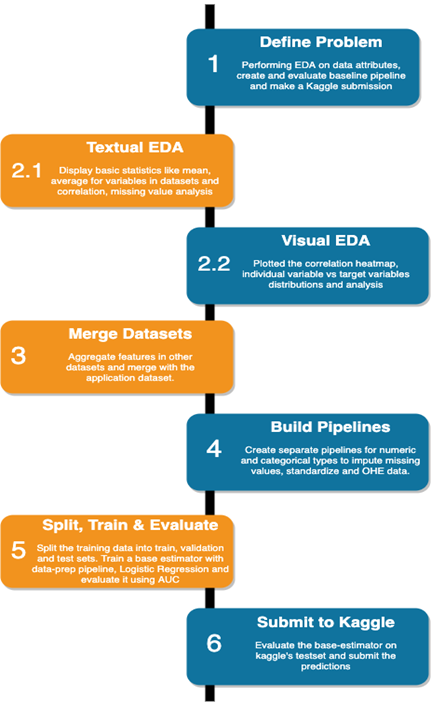

## Experimental results and Discussion
Tables below report the test AUC of the Random Forest Classifier, Gradient Boost classifiers like Xgboost and LightGBM results. Best of three achieved is from LightGBM Classifier. For LightGBMpipeline, the AUC is 0.7587 and the test accuracy is 92.4.For XGBoost pipeline, the AUC is 0.7481 and the test accuracy is 91.84 and for the random forest classifier, the AUC is 0.7139 and test accuracy is 91.3. We have a significant increase in the test- AUC scores compared to Phase-1 as we have done robust feature engineering by working on outliers and Balancing the data. The Hyper-parameter tuning did help a little which is done using GridSearchCV.



#### LightGBM Results before and after GridSearchCV:








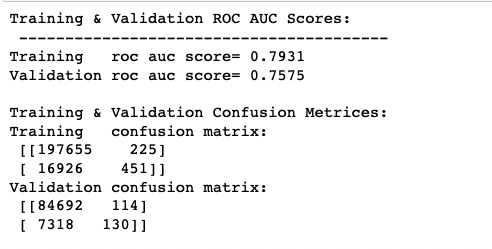

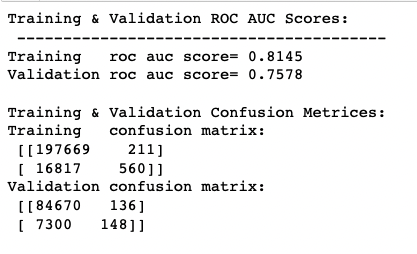

#### XGBoost Results:

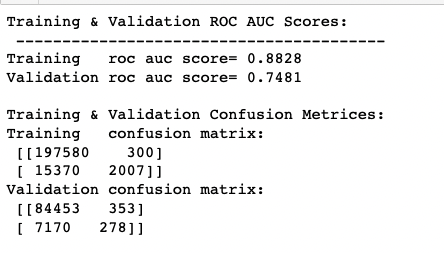

#### Random Forest Classifier Results:
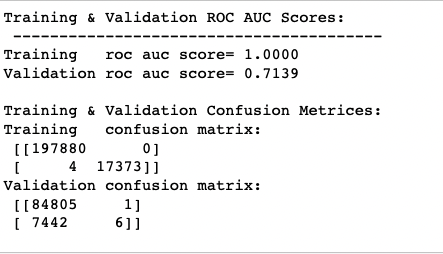

## Conclusion
The HCDR project predicts whether or not a client will repay a loan.These predictions are important as they will help banks to provide clients with loans who have no credit histories thus benefiting both the client and banks. 

In this phase we have performed feature engineering, feature selection, hyperparameter tuning, building a pipeline for models Random Forest, Gradient Boost & LightGBM, implemented ensemble stacking learning and made kaggle submission. 

We performed feature engineering steps such as data cleaning, deskewing the feature distributions, creation of new numerical and categorical features and merging the datasets with application dataset by grouping using current application id. We performed hyperparameter tuning using GridSearchCV and RandomSearchCV. We built base pipelines of Random Forest, Gradient Boost and Adaboost and then tuned hyperparameters for these models. 

LightGBM pipeline performed the best among all the models and the test AUC was 0.7587. We made Kaggle submission for all model learning pipelines. The LightGBM performed the best with a kaggle public score of 0.74843 and private score of 0.74472.  

**Our next steps include:**
* In the next phase, we will be extending our phase2 implementation to build a deep learning model to make predictions using MLP in Pytorch.

## Kaggle Submission

Submission Link: https://www.kaggle.com/competitions/home-credit-default-risk/submissions
Please find a screenshot of our best kaggle submission.   

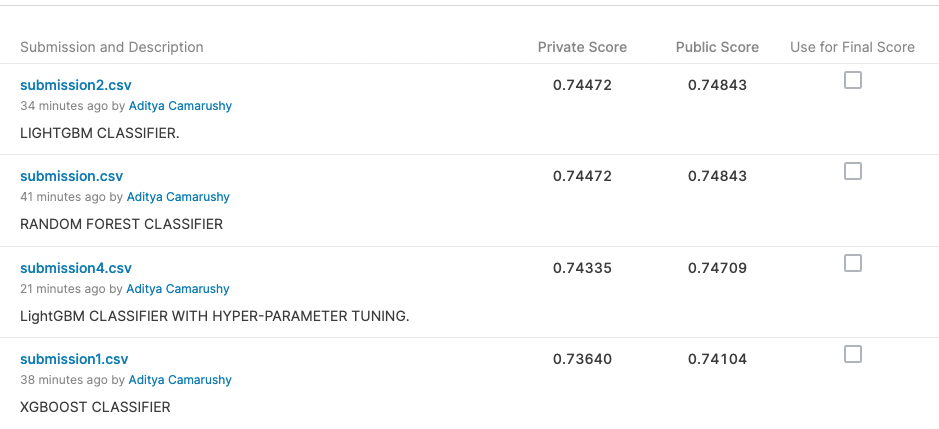

#  TODO: Predicting Loan Repayment with Automated Feature Engineering in Featuretools

Read the following:
* feature engineering via Featuretools library: 
  * https://github.com/Featuretools/predict-loan-repayment/blob/master/Automated%20Loan%20Repayment.ipynb
* https://www.analyticsvidhya.com/blog/2018/08/guide-automated-feature-engineering-featuretools-python/
* feature engineering paper: https://dai.lids.mit.edu/wp-content/uploads/2017/10/DSAA_DSM_2015.pdf
* https://www.analyticsvidhya.com/blog/2017/08/catboost-automated-categorical-data/